In [1]:
from IPython.display import display, HTML, Image
display(HTML("<style>.container { width:95% !important; }</style>"))

%load_ext autoreload
%autoreload 2

import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)
import matplotlib.cbook
warnings.simplefilter(action='ignore', category=matplotlib.cbook.MatplotlibDeprecationWarning)

import os
import numpy as np
import pandas as pd
import scanpy as sc
from scipy.sparse import csr_matrix
import scvelo as scv
import matplotlib.pyplot as plt

import sys
sys.path.append("../../lib")


# from deg_utils import DEGonAnnData
# from pathways import genesDicts

# from scanpy.tools._score_genes import score_genes

# from cheatmap import cplot, prepForCplot
# from pathways import genesDicts
# from vplot import wrapVplotRatio, wrapVplotScore, wrapVplotGene
from stpalette import palette_WM4007_rna, palette_WM4237_rna
from pathways import genesDicts
from plots import plotSpatialAll
from plots import plotPhiHeatmap, plotFiForAd
from utils import computFullGridVelocity, getGridPhi, getGridVelocityForSourceSink, getFiOfEmb, loadAddLayersVelocytoData

C:\Users\domans\AppData\Local\Temp\ipykernel_19688\2702650159.py:10: MatplotlibDeprecationWarning: MatplotlibDeprecationWarning was deprecated in Matplotlib 3.6 and will be removed two minor releases later. Use matplotlib.MatplotlibDeprecationWarning instead.
  warnings.simplefilter(action='ignore', category=matplotlib.cbook.MatplotlibDeprecationWarning)


In [2]:
# scv.pl.velocity_embedding(ad_all_temp_T, basis='X_umap', arrow_size=2, arrow_length=2, color=identity, palette=palette_rna, title='', size=75, alpha=0.75, legend_loc='none')
# scv.pl.velocity_embedding_grid(ad_all_temp_T, basis='X_umap', density=1, arrow_size=2, arrow_length=2, color=identity, palette=palette_rna, title='', size=75, alpha=0.75, legend_loc='none')
# ad_temp = ad_all_temp_T[ad_all_temp_T.obs['sample']=='WM4237_T2_S1_ST'].copy()
# sc.pl.spatial(ad_temp, color=['cluster', 'Fi_umap'], cmap='bwr', spot_size=450)
# # sc.pl.violin(ad_all_temp_T, keys='Fi_umap', groupby='cluster')

In [3]:
model = 'WM4007'

In [4]:
palette_rna = palette_WM4007_rna if model=='WM4007' else palette_WM4237_rna

In [5]:
initialLibrarySizes = {'WM4007_T0_S1_ST': 30967.0,
                    'WM4007_T0_S2_ST': 31210.0,
                    'WM4007_T1_S1_ST': 27910.0,
                    'WM4007_T1_S2_ST': 28700.0,
                    'WM4007_T2_S1_ST': 20318.0,
                    'WM4007_T2_S2_ST': 14094.0,
                    'WM4007_T3_S1_ST': 25289.0,
                    'WM4007_T3_S2_ST': 24304.0,
                    'WM4007_T4_S1_ST': 26625.0,
                    'WM4007_T4_S2_ST': 30744.0,
                    'WM4007_TC_S1_ST': 26802.0,
                    'WM4007_TC_S2_ST': 37152.0}

In [6]:
dataPath = '../../data/'
preprocessedStDataPath = 'd:/from HPCC 11 28 2022/results_NF1-nod-t2t-k35/%s/' % model
preprocessedVelDataPath = 'd:/from HPCC 11 28 2022/results_NF3-nod-t2t-k35/%s/' % model

ids = sorted(np.loadtxt(dataPath + 'ids_%s_ST.txt' % model, dtype=str))
print(ids, '\n')

ids = pd.Series(ids)
cond1 = ids.str.contains('E_S')
cond2 = ids.str.contains('0_S')
cond3 = ids.str.contains('C_S')
#ids = ids[cond1].values.tolist() + ids[cond2].values.tolist() + ids[cond3].values.tolist() + ids[~cond1 & ~cond2 & ~cond3].values.tolist()
ids = ids[cond2].values.tolist() + ids[cond3].values.tolist() + ids[~cond1 & ~cond2 & ~cond3].values.tolist()
# ids = ids.values.tolist()
print(ids)

['WM4007_T0_S1_ST', 'WM4007_T0_S2_ST', 'WM4007_T1_S1_ST', 'WM4007_T1_S2_ST', 'WM4007_T2_S1_ST', 'WM4007_T2_S2_ST', 'WM4007_T3_S1_ST', 'WM4007_T3_S2_ST', 'WM4007_T4_S1_ST', 'WM4007_T4_S2_ST', 'WM4007_TC_S1_ST', 'WM4007_TC_S2_ST'] 

['WM4007_T0_S1_ST', 'WM4007_T0_S2_ST', 'WM4007_TC_S1_ST', 'WM4007_TC_S2_ST', 'WM4007_T1_S1_ST', 'WM4007_T1_S2_ST', 'WM4007_T2_S1_ST', 'WM4007_T2_S2_ST', 'WM4007_T3_S1_ST', 'WM4007_T3_S2_ST', 'WM4007_T4_S1_ST', 'WM4007_T4_S2_ST']


# Load

In [7]:
ad_all = sc.read(dataPath + 'ad_all_human_clustered_st_%s.h5ad' % model)
ad_all = ad_all[ad_all.obs['human_ratio'] > 0.25]
ad_all.shape

(10843, 17788)

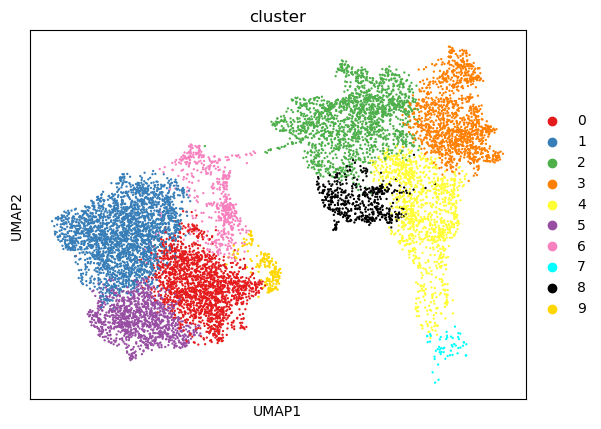

In [8]:
sc.pl.umap(ad_all, color='cluster', palette=palette_rna)

In [9]:
ads = {id: ad_all[ad_all.obs['sample']==id, :] for id in ids}

images = {id: sc.read(preprocessedStDataPath + '%s/st_adata_processed.h5ad' % id).uns['spatial'] for id in ids}

for sample in ids[:]:
    ads[sample] = ad_all[ad_all.obs['sample']==sample, :].copy()    
    ads[sample].uns['spatial'] = images[sample]

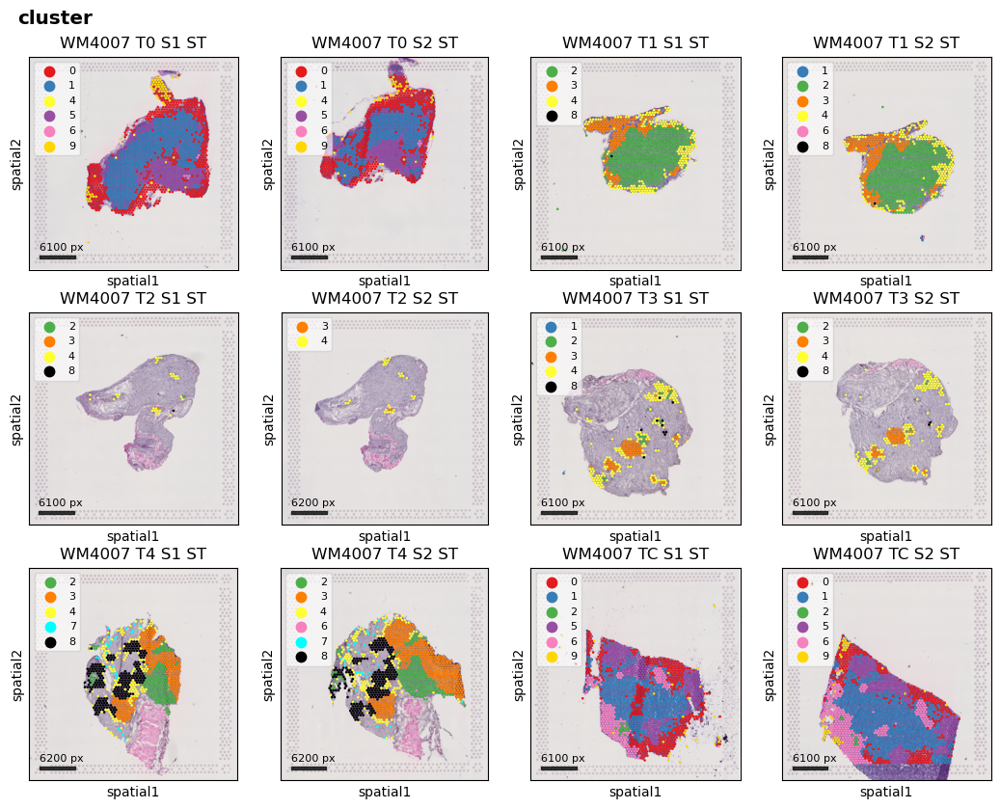

In [10]:
plotSpatialAll(ads, identity='cluster', palette=palette_rna, f=0.65)

Loaded WM4007_T0_S1_ST
Loaded WM4007_T0_S2_ST
Loaded WM4007_TC_S1_ST
Loaded WM4007_TC_S2_ST
Loaded WM4007_T1_S1_ST
Loaded WM4007_T1_S2_ST
Loaded WM4007_T2_S1_ST
Loaded WM4007_T2_S2_ST
Loaded WM4007_T3_S1_ST
Loaded WM4007_T3_S2_ST
Loaded WM4007_T4_S1_ST
Loaded WM4007_T4_S2_ST


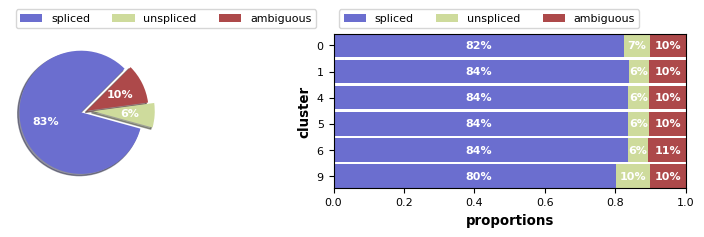

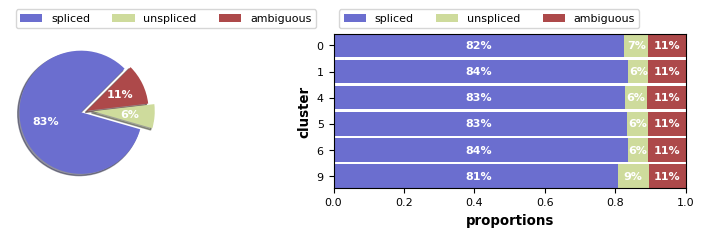

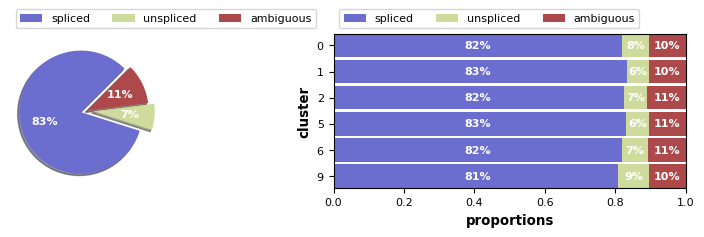

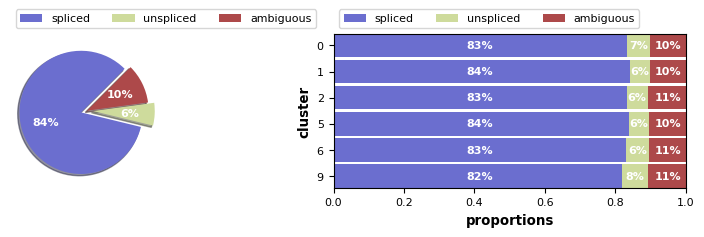

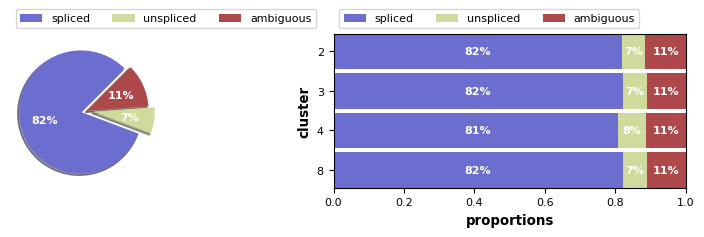

...

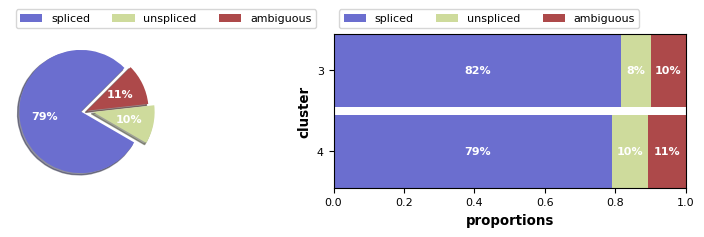

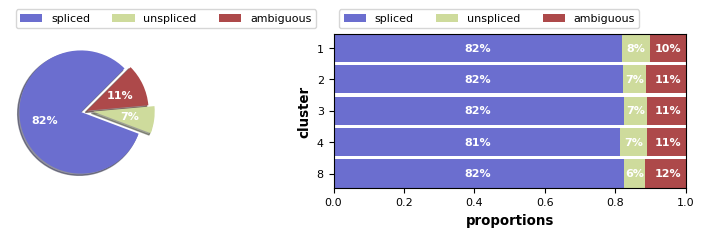

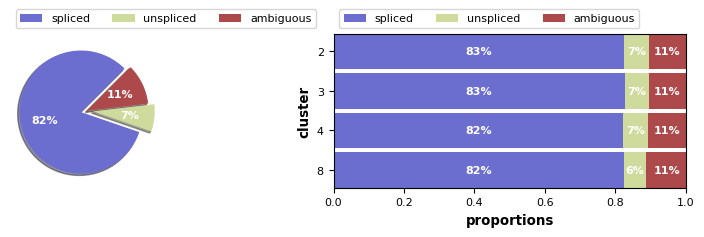

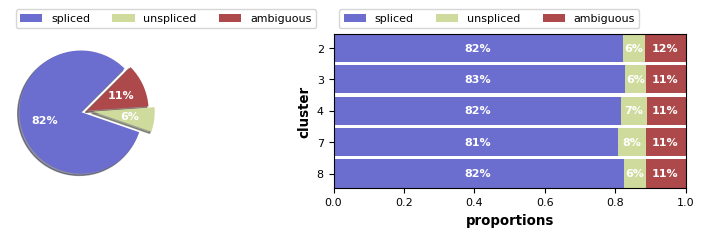

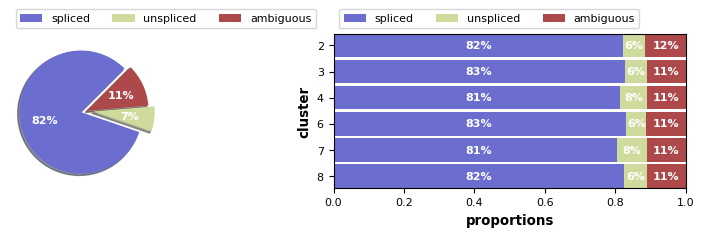

Normalized WM4007_T0_S1_ST
Normalized count data: X, spliced, unspliced.
Normalized WM4007_T0_S2_ST
Normalized count data: X, spliced, unspliced.
Normalized WM4007_TC_S1_ST
Normalized count data: X, spliced, unspliced.
Normalized WM4007_TC_S2_ST
Normalized count data: X, spliced, unspliced.
Normalized WM4007_T1_S1_ST
Normalized count data: X, spliced, unspliced.
Normalized WM4007_T1_S2_ST
Normalized count data: X, spliced, unspliced.
Normalized WM4007_T2_S1_ST
Normalized count data: X, spliced, unspliced.
Normalized WM4007_T2_S2_ST
Normalized count data: X, spliced, unspliced.
Normalized WM4007_T3_S1_ST
Normalized count data: X, spliced, unspliced.
Normalized WM4007_T3_S2_ST
Normalized count data: X, spliced, unspliced.
Normalized WM4007_T4_S1_ST
Normalized count data: X, spliced, unspliced.
Normalized WM4007_T4_S2_ST
Normalized count data: X, spliced, unspliced.


In [11]:
loadAddLayersVelocytoData(ids=ids[:], ads=ads, dataPath=preprocessedVelDataPath, identity='cluster', initialLibrarySizes=initialLibrarySizes)

In [12]:
def getLayersAll():   
    df_var = pd.concat([ads[id].var for id in ids])
    ad_all_temp = sc.concat({id:ads[id] for id in ids[:]}, label='sample', join='outer')
    ad_all_temp.var = df_var.loc[~df_var.index.duplicated()].reindex(ad_all_temp.var.index)
    ad_all_temp = ad_all_temp[:, ad_all_temp.var['is_human_gene']]
    return ad_all_temp.layers['spliced'], ad_all_temp.layers['unspliced'], ad_all_temp.obs.index, ad_all_temp.var.index

layer_spliced, layer_unspliced, spots, genes = getLayersAll()

In [13]:
ad_all_temp = ad_all[spots, genes].copy()
ad_all_temp.layers['spliced'] = layer_spliced
ad_all_temp.layers['unspliced'] = layer_unspliced
del layer_spliced, layer_unspliced

# Calculate velocity for the entire model

In [14]:
scv.tl.velocity_graph(ad_all_temp, basis='umap')

or is corrupted (e.g. due to subsetting). Consider recomputing with `pp.neighbors`.
computing neighbors
    finished (0:00:45) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:31) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)
computing velocities
    finished (0:00:41) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 1/8 cores)


  0%|          | 0/10843 [00:00<?, ?cells/s]

    finished (0:00:21) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


computing velocity embedding
    finished (0:00:04) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


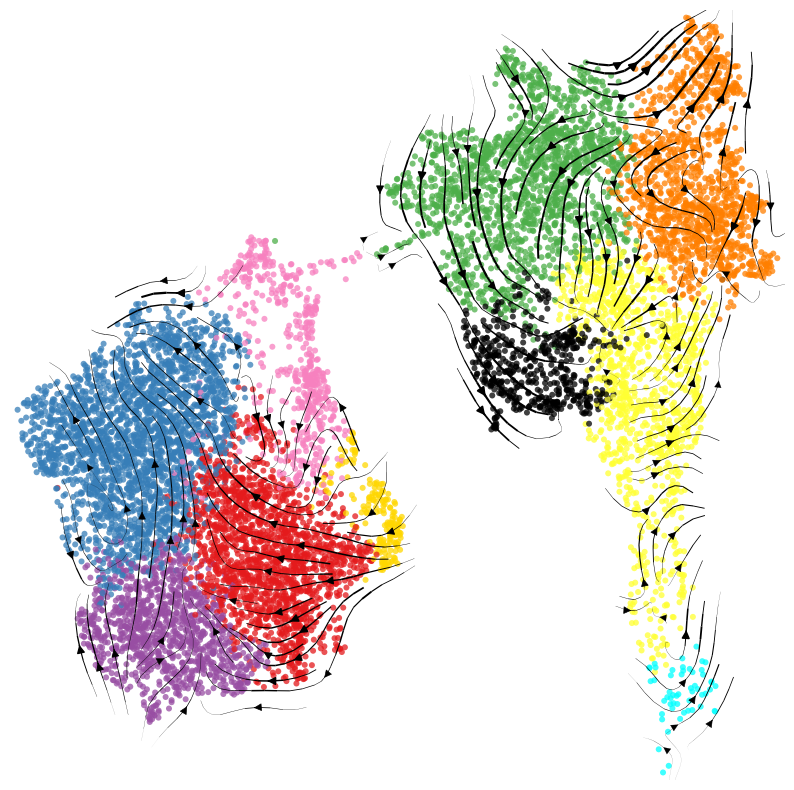

In [15]:
plt.rcParams["figure.figsize"] = (10,10)
identity = 'cluster'
scv.pl.velocity_embedding_stream(ad_all_temp, basis='X_umap', arrow_size=1.2, color=identity, palette=palette_rna, title='', size=75, alpha=0.75, legend_loc='none')

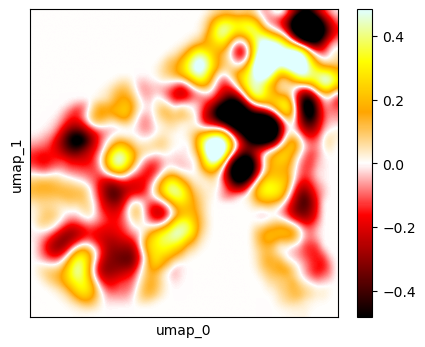

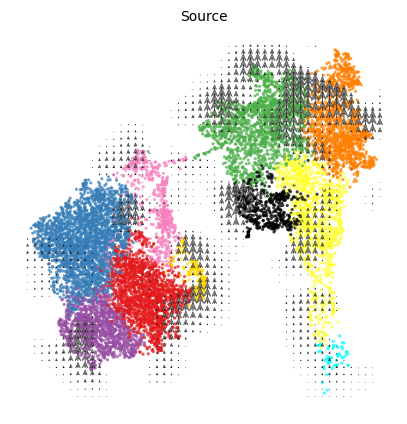

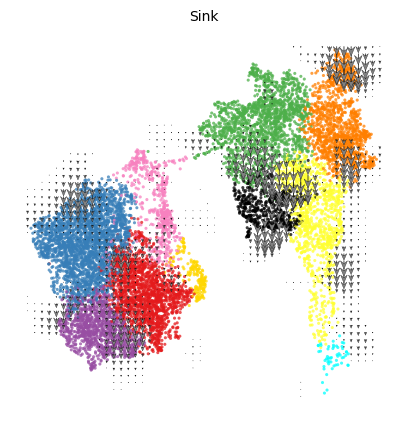

C:\Users\domans\Anaconda3\envs\sc\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:163: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = copy(get_cmap(cmap))


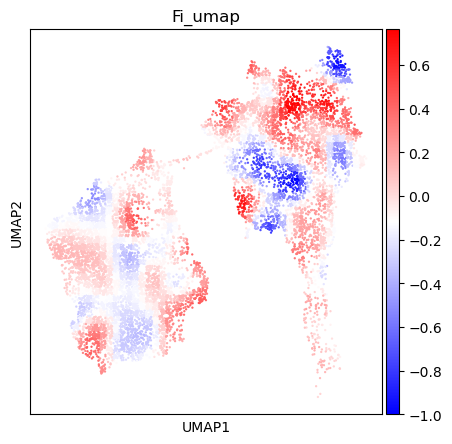

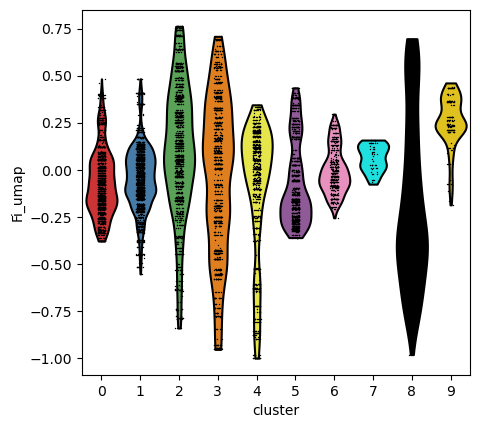

In [16]:
plt.rcParams["figure.figsize"] = (5,5)
plotFiForAd(ad_all_temp, size=20, identity='cluster', palette=palette_rna)

In [17]:
# plt.rcParams["figure.figsize"] = (50,50)
# scv.pl.velocity_embedding(ad_all_temp, basis='X_umap', arrow_size=1, arrow_length=5, color=identity, palette=palette_rna, title='', size=75, alpha=0.75, legend_loc='none')

In [18]:
# plt.rcParams["figure.figsize"] = (25,25)
# scv.pl.velocity_embedding(ad_all_temp, basis='X_umap', arrow_size=1, arrow_length=5, color=identity, palette=palette_rna, title='', size=75, alpha=0.75, legend_loc='none')

In [19]:
# plt.rcParams["figure.figsize"] = (5,5)
# scv.pl.velocity(ad_all_temp, ['DUSP10'], color=identity, palette=palette_rna, ncols=3, basis='X_umap')

In [24]:
ad_all_temp.write('d:/data_cache/' + 'ad_all_temp_velocity.h5ad')

# Load data

In [7]:
ad_all_temp = sc.read('d:/data_cache/' + 'ad_all_temp_velocity.h5ad')

In [26]:
print(genesDicts['MELANOGENESIS'])

['CREB3', 'ADCY1', 'ADCY2', 'ADCY3', 'ADCY5', 'ADCY6', 'FZD10', 'ADCY7', 'ADCY8', 'ADCY9', 'CREB1', 'CREBBP', 'CREB3L4', 'CTNNB1', 'CALML6', 'DCT', 'DVL1', 'DVL2', 'DVL3', 'EDN1', 'EDNRB', 'ADCY4', 'EP300', 'PLCB1', 'FZD2', 'GNAI1', 'GNAI2', 'GNAI3', 'GNAO1', 'GNAQ', 'GNAS', 'GSK3B', 'HRAS', 'KIT', 'KRAS', 'MC1R', 'KITLG', 'MITF', 'ASIP', 'NRAS', 'LEF1', 'WNT16', 'CALML5', 'PLCB2', 'PLCB3', 'PLCB4', 'WNT4', 'POMC', 'PRKACA', 'PRKACB', 'PRKACG', 'PRKCA', 'PRKCB', 'PRKCG', 'MAPK1', 'MAPK3', 'MAP2K1', 'MAP2K2', 'PRKX', 'RAF1', 'CREB3L2', '', 'TCF7', 'TCF7L2', 'TYR', 'TYRP1', 'WNT1', 'WNT2', 'WNT3', 'WNT5A', 'WNT6', 'WNT7A', 'WNT7B', 'WNT8A', 'WNT8B', 'WNT10B', 'WNT11', 'WNT2B', 'WNT9A', 'WNT9B', 'FZD5', 'FZD3', 'CALM1', 'WNT10A', 'CALM2', 'CALM3', 'CALML3', 'WNT5B', 'CAMK2A', 'CAMK2B', 'CAMK2D', 'CAMK2G', 'FZD1', 'FZD4', 'FZD6', 'FZD7', 'FZD8', 'FZD9', 'TCF7L1', 'CREB3L3', 'WNT3A', 'CREB3L1']


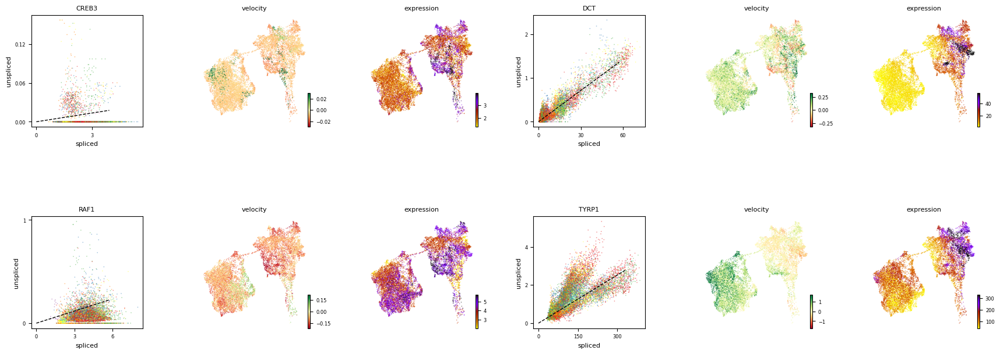

In [27]:
plt.rcParams["figure.figsize"] = (7,7)
scv.pl.velocity(ad_all_temp, ['CREB3', 'DCT', 'RAF1', 'TYRP1'], ncols=2)

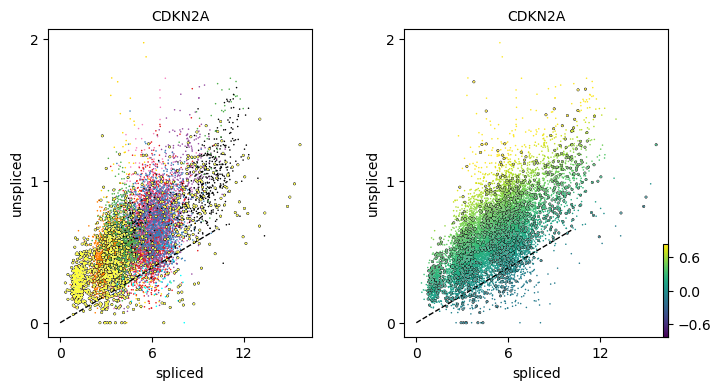

In [25]:
plt.rcParams["figure.figsize"] = (4,4)
scv.pl.scatter(ad_all_temp, 'CDKN2A', color=['cluster', 'velocity'], size=5, palette=palette_rna, wspace=0.35, add_outline='4') # '3, 4'

In [16]:
# This step needs plenty of memory
scv.tl.rank_velocity_genes(ad_all_temp, groupby='cluster', min_corr=0.3)

df = scv.DataFrame(ad_all_temp.uns['rank_velocity_genes']['names'])
df.head()

ranking velocity genes
    finished (0:00:01) --> added 
    'rank_velocity_genes', sorted scores by group ids (adata.uns) 
    'spearmans_score', spearmans correlation scores (adata.var)


,0,1,2,3,4,5,6,7,8,9
0,RPS8,COX7C,MARS,HPS4,NRG3,PHF19,TM4SF19,OSBPL10,DAPL1,USP53
1,HMCN1,RPS4X,PSPH,AC110285.1,CHCHD6,LAMA4,MALAT1,EPHA4,ABCB4,RPS8
2,LHFPL3-AS1,MLANA,LINC00520,LINC00173,OSBPL10,MLANA,TRPM1,BIRC7,TECPR1,PIR
3,ITPR2,MCM4,STAT1,KCNU1,CCDC154,SOD2,IFIH1,PTPRZ1,PMEL,HMGA2
4,MAP2,MFSD12,OAS1,TECPR1,LENG8,COX7C,RPS8,MKNK2,PLCD4,CNTNAP3B


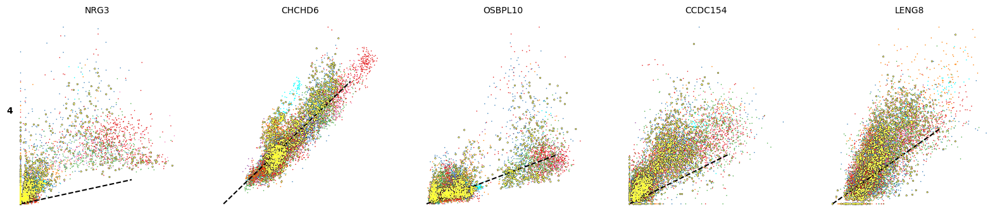

In [26]:
kwargs = dict()
scv.pl.scatter(ad_all_temp, df['4'][:5], ylabel='4', frameon=False, size=5, linewidth=1.5, add_outline='4')

In [21]:
df

,0,1,2,3,4,5,6,7,8,9
0,RPS8,COX7C,MARS,HPS4,NRG3,PHF19,TM4SF19,OSBPL10,DAPL1,USP53
1,HMCN1,RPS4X,PSPH,AC110285.1,CHCHD6,LAMA4,MALAT1,EPHA4,ABCB4,RPS8
2,LHFPL3-AS1,MLANA,LINC00520,LINC00173,OSBPL10,MLANA,TRPM1,BIRC7,TECPR1,PIR
3,ITPR2,MCM4,STAT1,KCNU1,CCDC154,SOD2,IFIH1,PTPRZ1,PMEL,HMGA2
4,MAP2,MFSD12,OAS1,TECPR1,LENG8,COX7C,RPS8,MKNK2,PLCD4,CNTNAP3B
...,...,...,...,...,...,...,...,...,...,...
95,PSMB9,ACAT2,IGSF8,FDPS,EMP1,TMEM132D-AS1,ZC3H13,CREB5,HSF4,IFI27
96,BCAN,NFKB2,GBE1,IGSF8,ISG20,PTPDC1,COX7C,TMEM106C,TSPAN5,AMDHD2
97,PIDD1,SVIL,CCDC136,PIR,SLC7A11,DDX60,PSMB9,OAS1,NCOA7,IFIH1
98,CDKN2A,SUGP2,RHOJ,DDX60L,HIST1H2BD,PMEL,LINC01531,DUSP10,HERC6,PLCD4


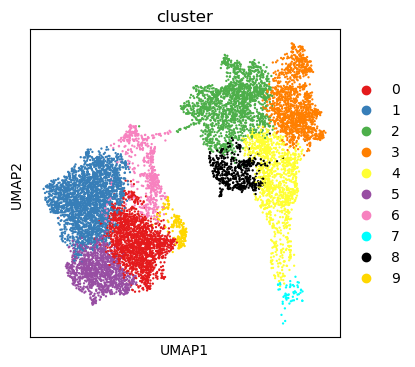

In [19]:
sc.pl.umap(ad_all_temp, color='cluster')

In [20]:
# df.to_csv(f'vel_rank_genes_by_rna_cluster_{model}.csv')

In [27]:
scv.tl.velocity_confidence(ad_all_temp)

--> added 'velocity_length' (adata.obs)
--> added 'velocity_confidence' (adata.obs)
--> added 'velocity_confidence_transition' (adata.obs)


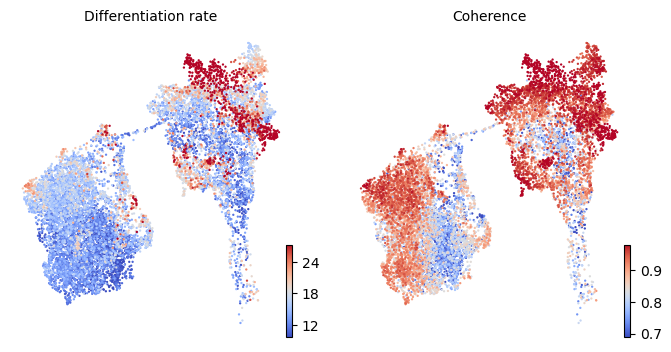

In [32]:
keys = 'velocity_length', 'velocity_confidence'
scv.pl.scatter(ad_all_temp, c=keys, cmap='coolwarm', perc=[5, 95], title=['Differentiation rate', 'Coherence'])

In [30]:
df = ad_all_temp.obs.groupby('cluster')[keys].mean().T
df.style.background_gradient(cmap='coolwarm', axis=1)

cluster,0,1,2,3,4,5,6,7,8,9
velocity_length,12.108517,14.415268,19.057934,20.313358,13.635628,12.378943,15.994711,16.219259,18.924404,17.532187
velocity_confidence,0.769396,0.887534,0.921230,0.946580,0.815062,0.853147,0.791458,0.803038,0.930656,0.805270


In [37]:
scv.tl.paga(ad_all_temp, groups='cluster')

computing terminal states
    identified 1 region of root cells and 3 regions of end points .
    finished (0:00:01) --> added
    'root_cells', root cells of Markov diffusion process (adata.obs)
    'end_points', end points of Markov diffusion process (adata.obs)
running PAGA using priors: ['velocity_pseudotime']
    finished (0:00:04) --> added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns)
    'paga/transitions_confidence', velocity transitions (adata.uns)


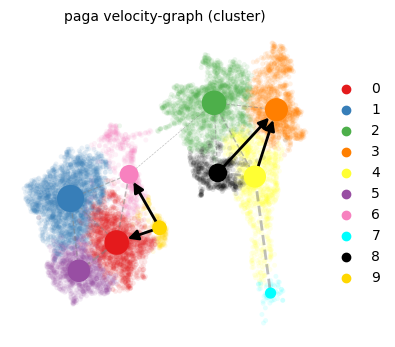

In [38]:
scv.pl.paga(ad_all_temp, basis='umap', size=50, alpha=0.1, min_edge_width=2, node_size_scale=1.5)

In [39]:
from vplot import wrapVplotRatio, wrapVplotScore, wrapVplotGene

IndexError: list index out of range

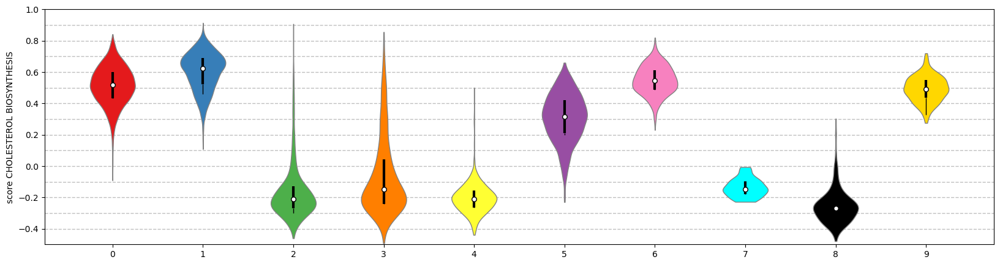

In [43]:
for geneset in ['HOEK_INVASIVE', 'CHOLESTEROL_METABOLISM', 'CHOLESTEROL_BIOSYNTHESIS'][2:]:
    wrapVplotScore(geneset, genesDicts=genesDicts, identity='cluster', palette=palette_rna, ads={'all': ad_all_temp}, ids=['all'])

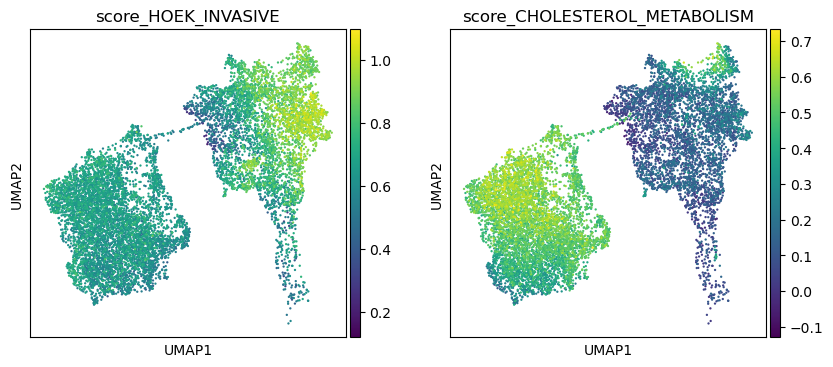

In [47]:
sc.pl.umap(ad_all_temp, color=['score_HOEK_INVASIVE', 'score_CHOLESTEROL_METABOLISM'])

# Calculate velocity on UMAP per timepoint

computing velocities
    finished (0:00:04) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 4/8 cores)


  0%|          | 0/3423 [00:00<?, ?cells/s]

    finished (0:00:17) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


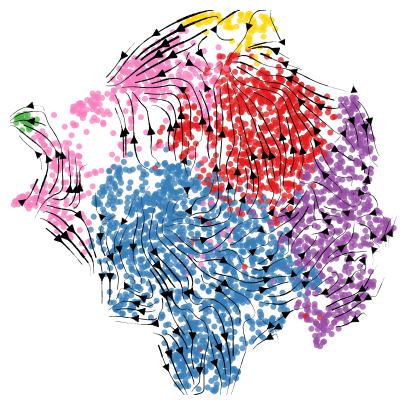

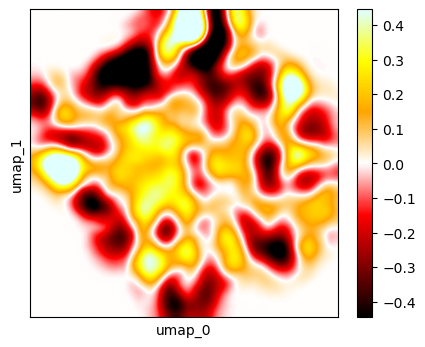

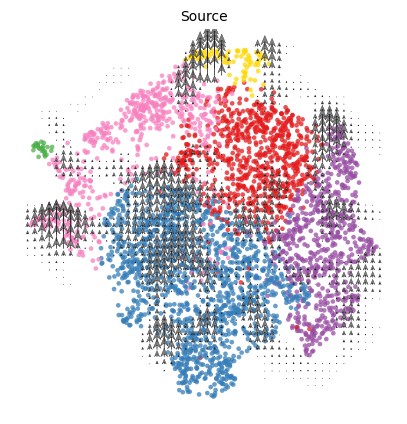

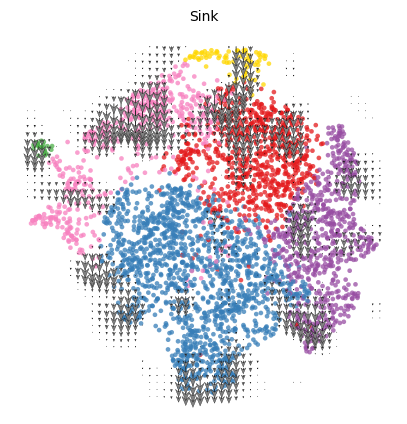

C:\Users\domans\Anaconda3\envs\sc\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:163: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = copy(get_cmap(cmap))


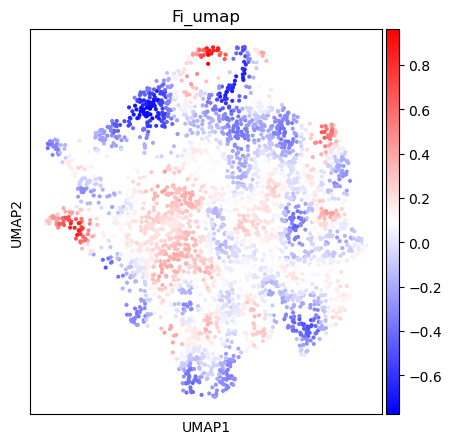

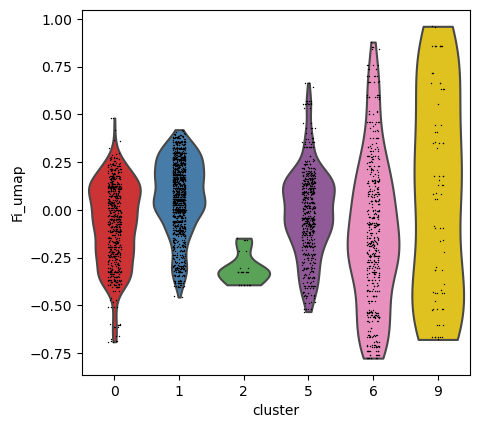

In [25]:
ad_all_temp_T = ad_all_temp[ad_all_temp.obs['T'].isin(['TC']), :]
sc.pp.neighbors(ad_all_temp_T, use_rep='X_pca_harmony')
sc.tl.umap(ad_all_temp_T)
scv.tl.velocity(ad_all_temp_T, mode='stochastic')
scv.tl.velocity_graph(ad_all_temp_T, n_jobs=4, basis='umap')
plt.rcParams["figure.figsize"] = (5, 5)
scv.pl.velocity_embedding_stream(ad_all_temp_T, basis='X_umap', arrow_size=1.2, color=identity, palette=palette_rna, title='', size=75, alpha=0.75, legend_loc='none')
plotFiForAd(ad_all_temp_T)

computing velocities
    finished (0:00:04) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 4/8 cores)


  0%|          | 0/2785 [00:00<?, ?cells/s]

    finished (0:00:04) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


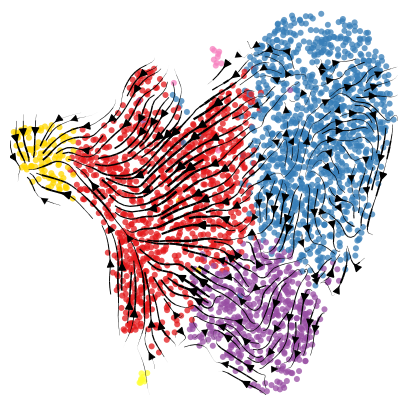

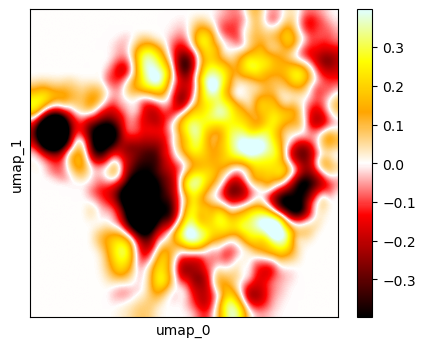

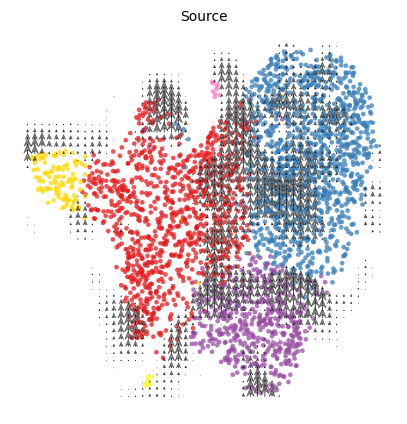

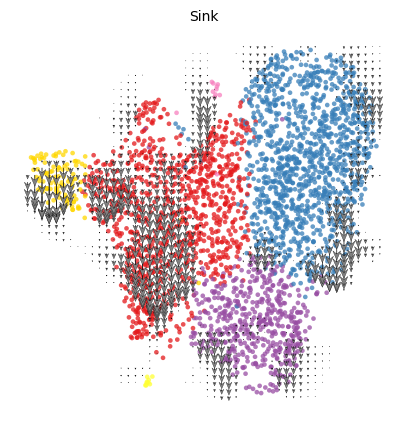

C:\Users\domans\Anaconda3\envs\sc\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:163: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = copy(get_cmap(cmap))


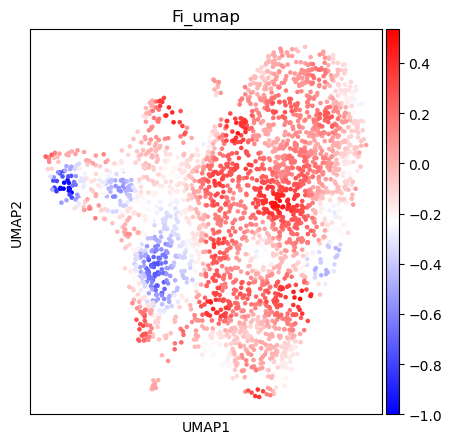

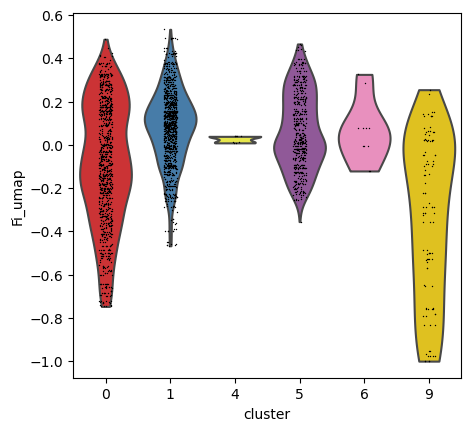

In [26]:
ad_all_temp_T = ad_all_temp[ad_all_temp.obs['T'].isin(['T0']), :]
sc.pp.neighbors(ad_all_temp_T, use_rep='X_pca_harmony')
sc.tl.umap(ad_all_temp_T)
scv.tl.velocity(ad_all_temp_T, mode='stochastic')
scv.tl.velocity_graph(ad_all_temp_T, n_jobs=4, basis='umap')
plt.rcParams["figure.figsize"] = (5, 5)
scv.pl.velocity_embedding_stream(ad_all_temp_T, basis='X_umap', arrow_size=1.2, color=identity, palette=palette_rna, title='', size=75, alpha=0.75, legend_loc='none')
plotFiForAd(ad_all_temp_T)

computing velocities
    finished (0:00:04) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 4/8 cores)


  0%|          | 0/1989 [00:00<?, ?cells/s]

    finished (0:00:04) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


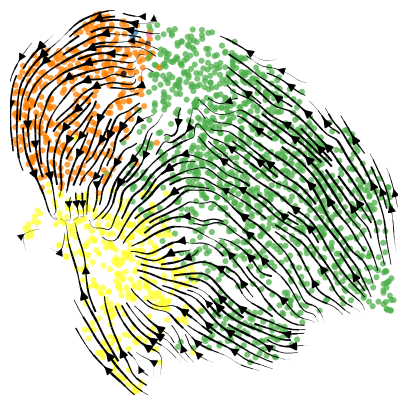

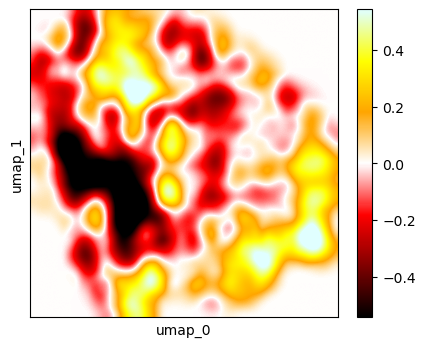

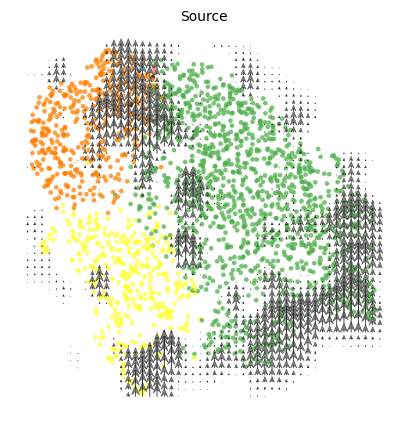

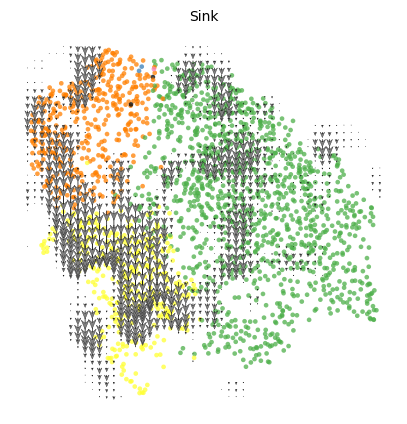

C:\Users\domans\Anaconda3\envs\sc\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:163: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = copy(get_cmap(cmap))


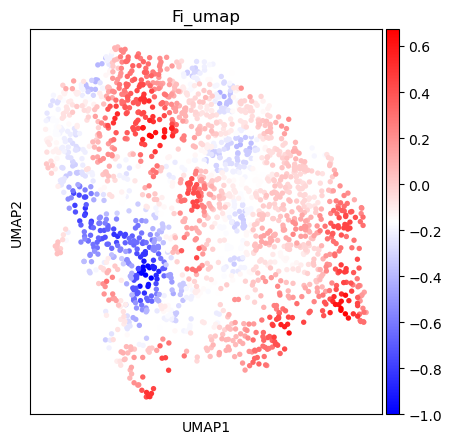

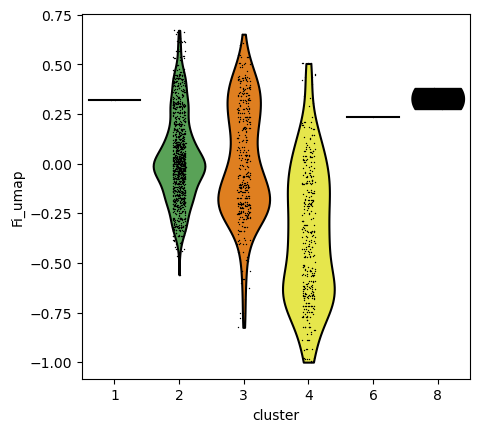

In [27]:
ad_all_temp_T = ad_all_temp[ad_all_temp.obs['T'].isin(['T1']), :]
sc.pp.neighbors(ad_all_temp_T, use_rep='X_pca_harmony')
sc.tl.umap(ad_all_temp_T)
scv.tl.velocity(ad_all_temp_T, mode='stochastic')
scv.tl.velocity_graph(ad_all_temp_T, n_jobs=4, basis='umap')
plt.rcParams["figure.figsize"] = (5, 5)
scv.pl.velocity_embedding_stream(ad_all_temp_T, basis='X_umap', arrow_size=1.2, color=identity, palette=palette_rna, title='', size=75, alpha=0.75, legend_loc='none')
plotFiForAd(ad_all_temp_T)

computing velocities
    finished (0:00:00) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 4/8 cores)


  0%|          | 0/61 [00:00<?, ?cells/s]

    finished (0:00:01) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


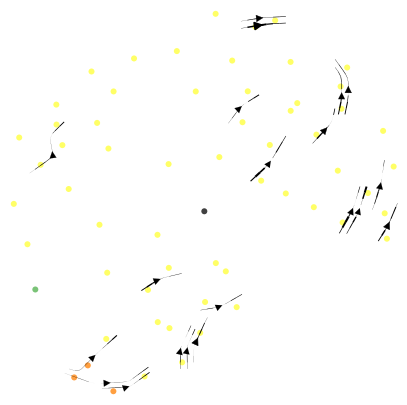

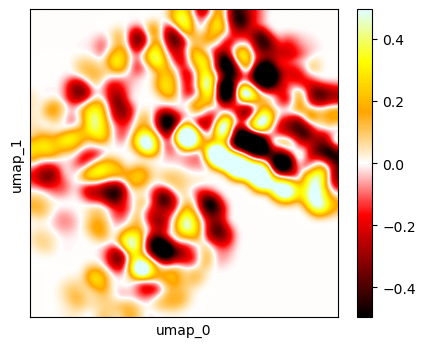

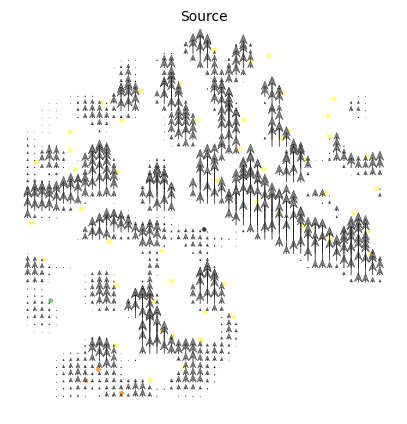

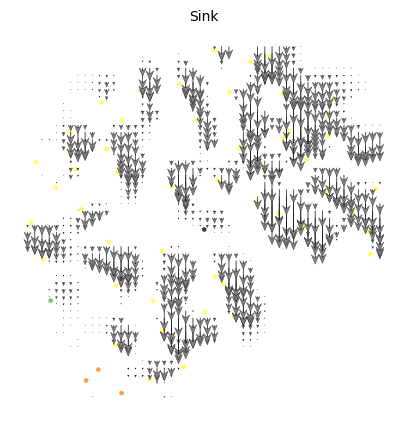

C:\Users\domans\Anaconda3\envs\sc\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:163: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = copy(get_cmap(cmap))


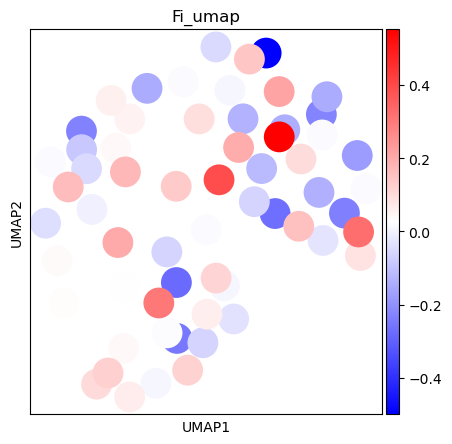

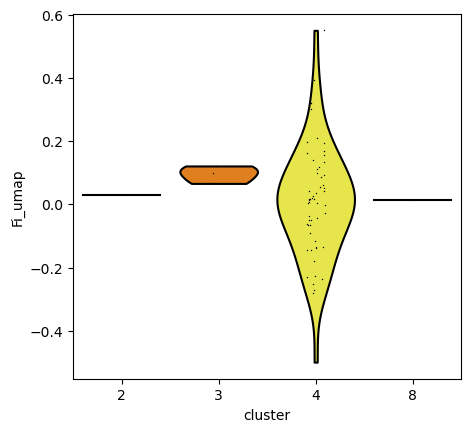

In [28]:
ad_all_temp_T = ad_all_temp[ad_all_temp.obs['T'].isin(['T2']), :]
sc.pp.neighbors(ad_all_temp_T, use_rep='X_pca_harmony')
sc.tl.umap(ad_all_temp_T)
scv.tl.velocity(ad_all_temp_T, mode='stochastic')
scv.tl.velocity_graph(ad_all_temp_T, n_jobs=4, basis='umap')
plt.rcParams["figure.figsize"] = (5, 5)
scv.pl.velocity_embedding_stream(ad_all_temp_T, basis='X_umap', arrow_size=1.2, color=identity, palette=palette_rna, title='', size=75, alpha=0.75, legend_loc='none')
plotFiForAd(ad_all_temp_T)

computing velocities
    finished (0:00:00) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 4/8 cores)


  0%|          | 0/526 [00:00<?, ?cells/s]

    finished (0:00:01) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


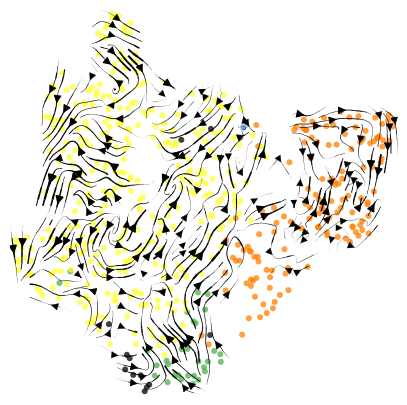

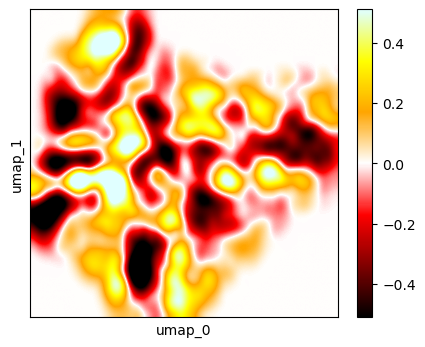

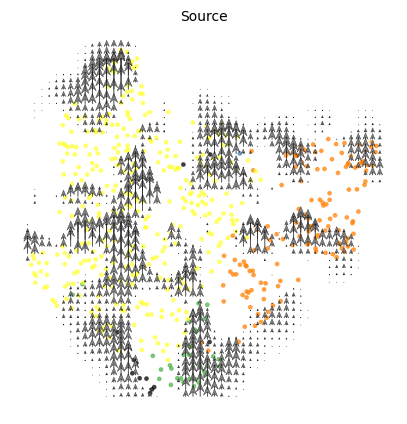

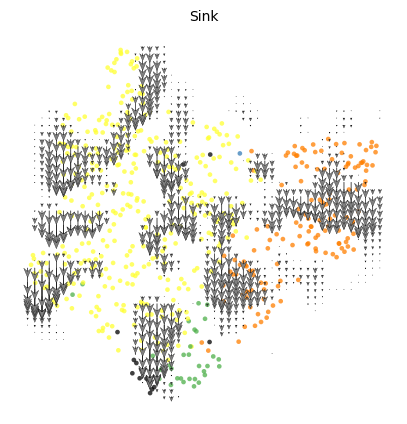

C:\Users\domans\Anaconda3\envs\sc\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:163: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = copy(get_cmap(cmap))


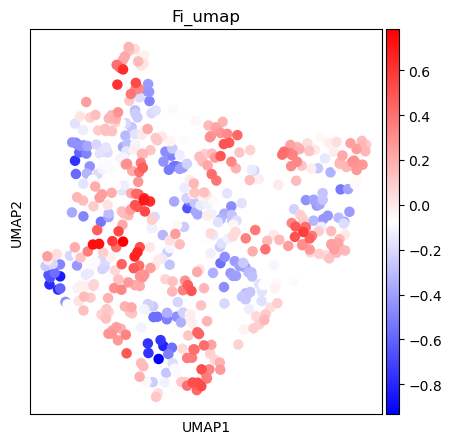

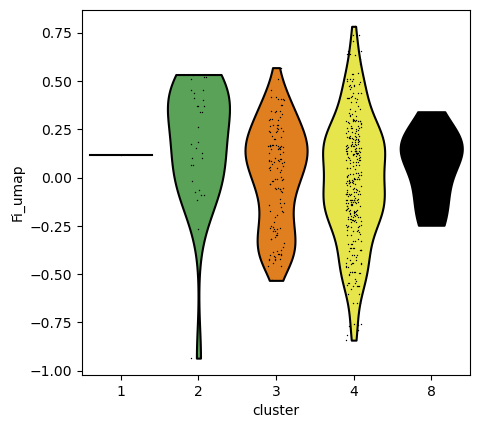

In [29]:
ad_all_temp_T = ad_all_temp[ad_all_temp.obs['T'].isin(['T3']), :]
sc.pp.neighbors(ad_all_temp_T, use_rep='X_pca_harmony')
sc.tl.umap(ad_all_temp_T)
scv.tl.velocity(ad_all_temp_T, mode='stochastic')
scv.tl.velocity_graph(ad_all_temp_T, n_jobs=4, basis='umap')
plt.rcParams["figure.figsize"] = (5, 5)
scv.pl.velocity_embedding_stream(ad_all_temp_T, basis='X_umap', arrow_size=1.2, color=identity, palette=palette_rna, title='', size=75, alpha=0.75, legend_loc='none')
plotFiForAd(ad_all_temp_T)

computing velocities
    finished (0:00:02) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 4/8 cores)


  0%|          | 0/2059 [00:00<?, ?cells/s]

    finished (0:00:04) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


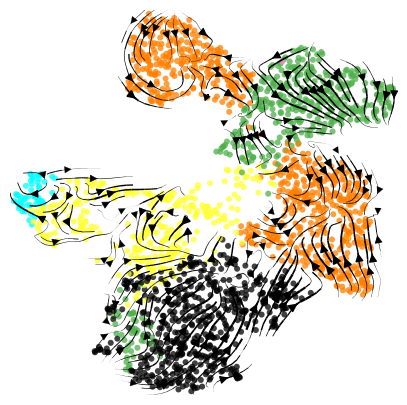

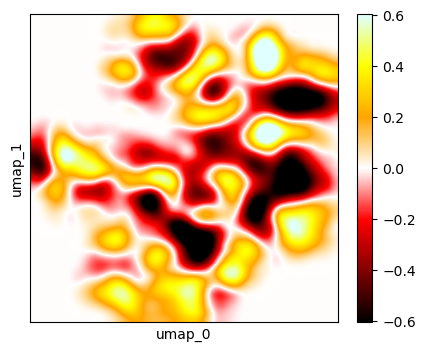

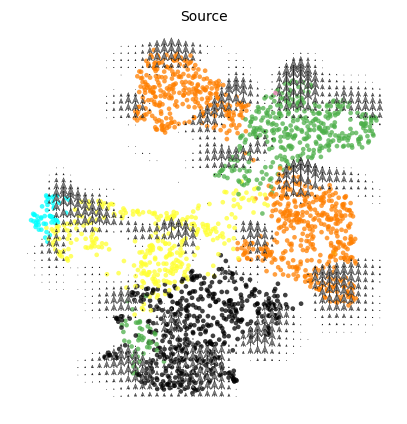

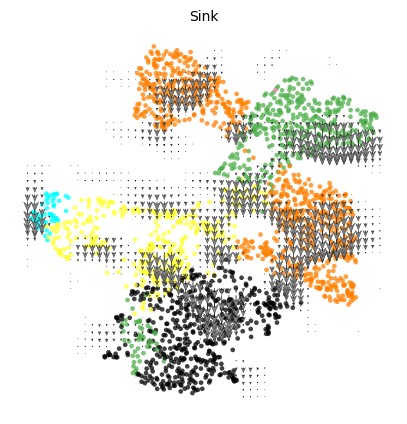

C:\Users\domans\Anaconda3\envs\sc\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:163: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = copy(get_cmap(cmap))


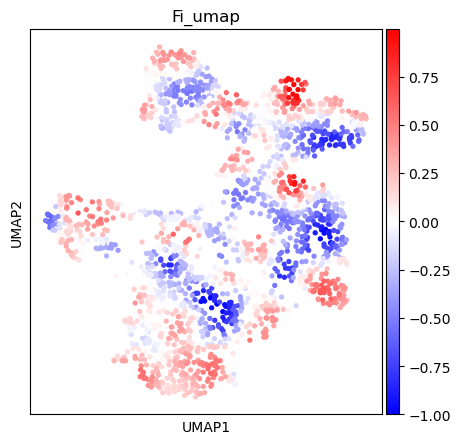

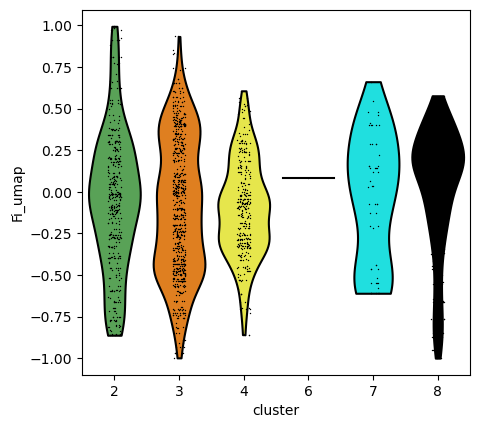

In [30]:
ad_all_temp_T = ad_all_temp[ad_all_temp.obs['T'].isin(['T4']), :]
sc.pp.neighbors(ad_all_temp_T, use_rep='X_pca_harmony')
sc.tl.umap(ad_all_temp_T)
scv.tl.velocity(ad_all_temp_T, mode='stochastic')
scv.tl.velocity_graph(ad_all_temp_T, n_jobs=4, basis='umap')
plt.rcParams["figure.figsize"] = (5, 5)
scv.pl.velocity_embedding_stream(ad_all_temp_T, basis='X_umap', arrow_size=1.2, color=identity, palette=palette_rna, title='', size=75, alpha=0.75, legend_loc='none')
plotFiForAd(ad_all_temp_T)

# Calculate velocity on the spatial layout

In [32]:
for id in ids[:]:
    try:
        print('\n\n\n', id)
        ad = ads[id]
        identity = 'cluster'
        scv.pp.moments(ad)
        scv.tl.velocity(ad, mode='stochastic')
        scv.pp.neighbors(ad)
        scv.tl.umap(ad)
        scv.tl.velocity_graph(ad, basis='umap')
        scv.tl.velocity_graph(ad, basis='spatial')
        ad.obsm['X_spatial'] = np.array([ad.obsm['spatial'].T[0], -ad.obsm['spatial'].T[1]]).T.astype(float)
    except Exception as exception:
        print(exception)




 WM4007_T0_S1_ST
computing moments based on connectivities
    finished (0:00:03) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)
computing velocities
    finished (0:00:01) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing neighbors
    finished (0:00:00) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 1/8 cores)


  0%|          | 0/1577 [00:00<?, ?cells/s]

    finished (0:00:01) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 1/8 cores)


  0%|          | 0/1577 [00:00<?, ?cells/s]

    finished (0:00:01) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)



 WM4007_T0_S2_ST
computing moments based on connectivities
    finished (0:00:02) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)
computing velocities
    finished (0:00:01) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing neighbors
    finished (0:00:00) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 1/8 cores)


  0%|          | 0/1208 [00:00<?, ?cells/s]

    finished (0:00:00) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 1/8 cores)


  0%|          | 0/1208 [00:00<?, ?cells/s]

    finished (0:00:00) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)



 WM4007_TC_S1_ST
computing moments based on connectivities
    finished (0:00:03) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)
computing velocities
    finished (0:00:01) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing neighbors
    finished (0:00:00) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 1/8 cores)


  0%|          | 0/1580 [00:00<?, ?cells/s]

    finished (0:00:01) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 1/8 cores)


  0%|          | 0/1580 [00:00<?, ?cells/s]

    finished (0:00:01) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)



 WM4007_TC_S2_ST
computing moments based on connectivities
    finished (0:00:04) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)
computing velocities
    finished (0:00:02) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing neighbors
    finished (0:00:00) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 1/8 cores)


  0%|          | 0/1843 [00:00<?, ?cells/s]

    finished (0:00:01) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 1/8 cores)


  0%|          | 0/1843 [00:00<?, ?cells/s]

    finished (0:00:01) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)



 WM4007_T1_S1_ST
computing moments based on connectivities
    finished (0:00:02) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)
computing velocities
    finished (0:00:01) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing neighbors
    finished (0:00:00) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 1/8 cores)


  0%|          | 0/962 [00:00<?, ?cells/s]

    finished (0:00:00) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 1/8 cores)


  0%|          | 0/962 [00:00<?, ?cells/s]

    finished (0:00:00) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)



 WM4007_T1_S2_ST
computing moments based on connectivities
    finished (0:00:02) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)
computing velocities
    finished (0:00:00) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing neighbors
    finished (0:00:00) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 1/8 cores)


  0%|          | 0/1027 [00:00<?, ?cells/s]

    finished (0:00:01) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 1/8 cores)


  0%|          | 0/1027 [00:00<?, ?cells/s]

    finished (0:00:01) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)



 WM4007_T2_S1_ST
computing moments based on connectivities
    finished (0:00:00) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)
computing velocities
SVD did not converge



 WM4007_T2_S2_ST
computing neighbors
    finished (0:00:00) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:00) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)
computing velocities
    finished (0:00:00) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing neighbors
    finished (0:00:00) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing ve

  0%|          | 0/29 [00:00<?, ?cells/s]

    finished (0:00:00) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 1/8 cores)


  0%|          | 0/29 [00:00<?, ?cells/s]

    finished (0:00:00) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)



 WM4007_T3_S1_ST
computing neighbors
    finished (0:00:00) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:00) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)
computing velocities
    finished (0:00:00) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing neighbors
    finished (0:00:00) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 1/8 cores)


  0%|          | 0/297 [00:00<?, ?cells/s]

    finished (0:00:00) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 1/8 cores)


  0%|          | 0/297 [00:00<?, ?cells/s]

    finished (0:00:00) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)



 WM4007_T3_S2_ST
computing neighbors
    finished (0:00:00) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:00) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)
computing velocities
    finished (0:00:00) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing neighbors
    finished (0:00:00) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 1/8 cores)


  0%|          | 0/229 [00:00<?, ?cells/s]

    finished (0:00:00) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 1/8 cores)


  0%|          | 0/229 [00:00<?, ?cells/s]

    finished (0:00:00) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)



 WM4007_T4_S1_ST
computing neighbors
    finished (0:00:00) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:02) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)
computing velocities
    finished (0:00:00) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing neighbors
    finished (0:00:00) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 1/8 cores)


  0%|          | 0/887 [00:00<?, ?cells/s]

    finished (0:00:00) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 1/8 cores)


  0%|          | 0/887 [00:00<?, ?cells/s]

    finished (0:00:00) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)



 WM4007_T4_S2_ST
computing neighbors
    finished (0:00:00) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:03) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)
computing velocities
    finished (0:00:01) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing neighbors
    finished (0:00:00) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 1/8 cores)


  0%|          | 0/1172 [00:00<?, ?cells/s]

    finished (0:00:01) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
        Consider computing the graph in an unbiased manner 
        on full expression space by not specifying basis.

computing velocity graph (using 1/8 cores)


  0%|          | 0/1172 [00:00<?, ?cells/s]

    finished (0:00:01) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


computing velocity embedding
'velocity'
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_spatial', embedded velocity vectors (adata.obsm)
The 'n_neighbors' parameter of NearestNeighbors must be an int in the range [1, inf) or None. Got 0 instead.
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_spatial', embedded velocity vectors (adata.obsm)
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_spatial', embedded velocity vectors (adata.obsm)
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_spatial', embedded velocity vectors (adata.obsm)
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_spatial', embedded velocity vectors (adata.obsm)


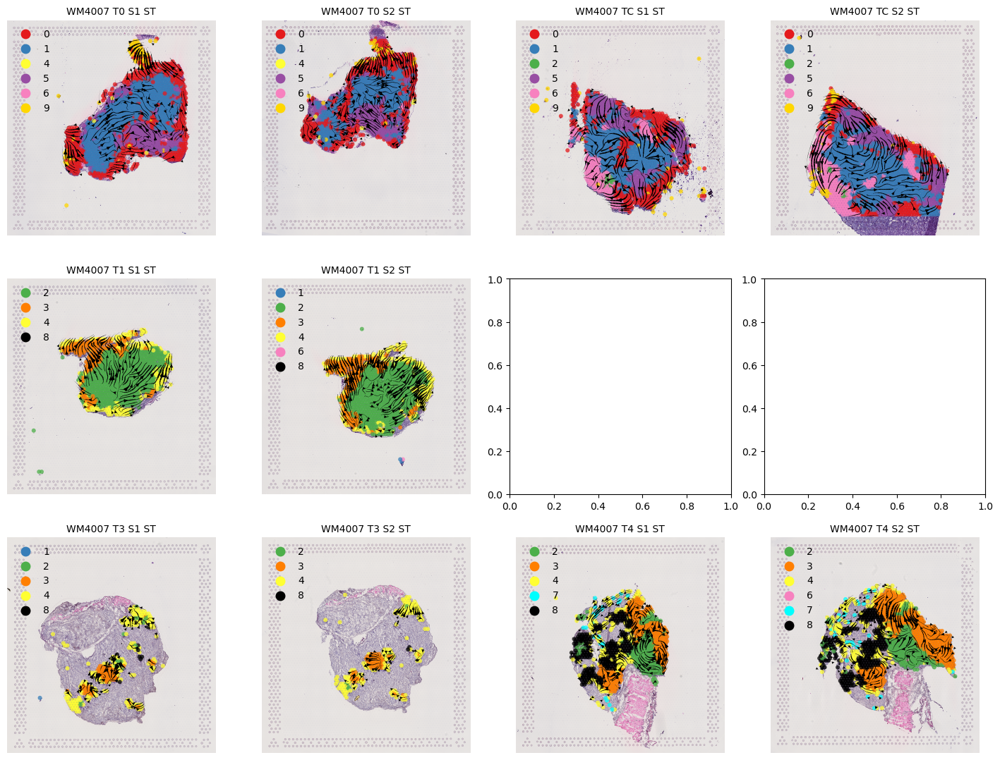

In [34]:
f = 1.0
ncols = 4
nrows = 3
fig, axs = plt.subplots(nrows, ncols, figsize=(f*4.5*ncols, f*4.5*nrows))
for isample, sample in enumerate(ids):
    try:
        ax = axs[int((isample - isample%ncols)/nrows), isample%ncols]
        identity = 'cluster'
        ad = ads[sample]

        scv.pl.velocity_embedding_stream(ad, basis='X_spatial', arrow_size=0.6, color=identity, palette=palette_rna, 
                                         title=sample, size=75, alpha=0.75, show=False, ax=ax, legend_loc='none') # 250 for 12x12

        (xmin, xmax), (ymin, ymax) = ax.get_xlim(), ax.get_ylim()
        sf = ads[sample].uns['spatial']['library_id']['scalefactors']['tissue_lowres_scalef']
        image = ad.uns['spatial']['library_id']['images']['lowres'].copy()
        ax.imshow(image, interpolation='none', extent=[0, image.shape[1]/sf, -20/sf-image.shape[1]/sf, 0], zorder=-1)

        ax.legend(frameon=False, loc='upper left', fontsize=10, markerscale=1.5)
    except Exception as exception:
        print(exception)

plt.subplots_adjust(wspace=0.15, hspace=0.2)
# fig.savefig('spatial rna velocity.png', dpi=450)

C:\Users\domans\Anaconda3\envs\sc\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:163: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = copy(get_cmap(cmap))


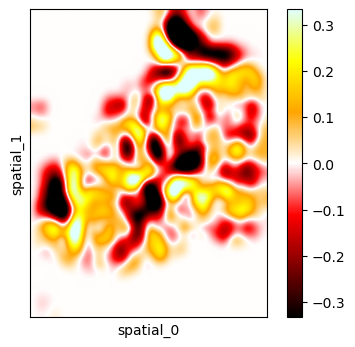

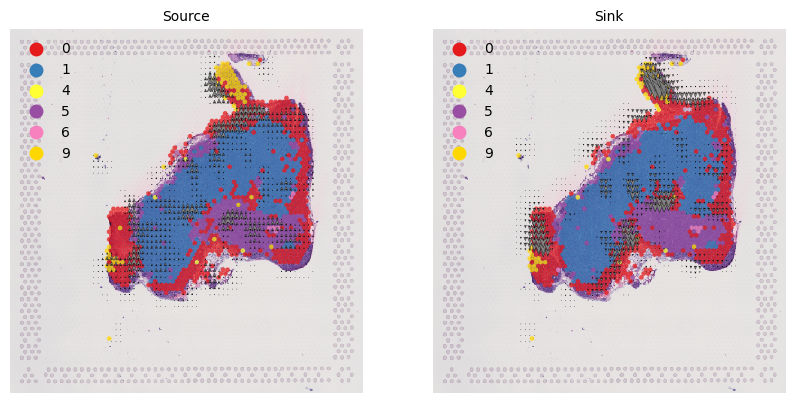

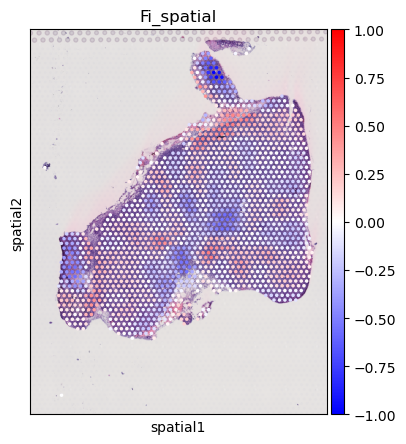

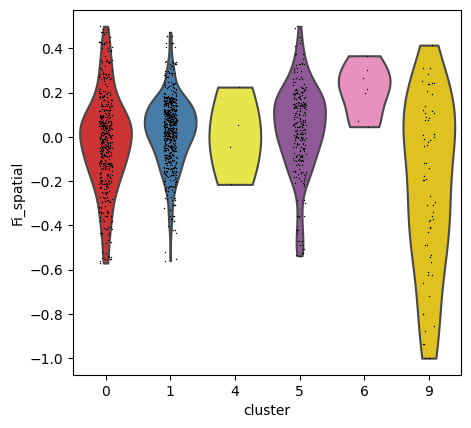

C:\Users\domans\Anaconda3\envs\sc\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:163: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = copy(get_cmap(cmap))


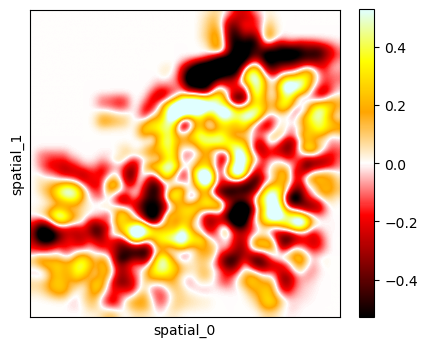

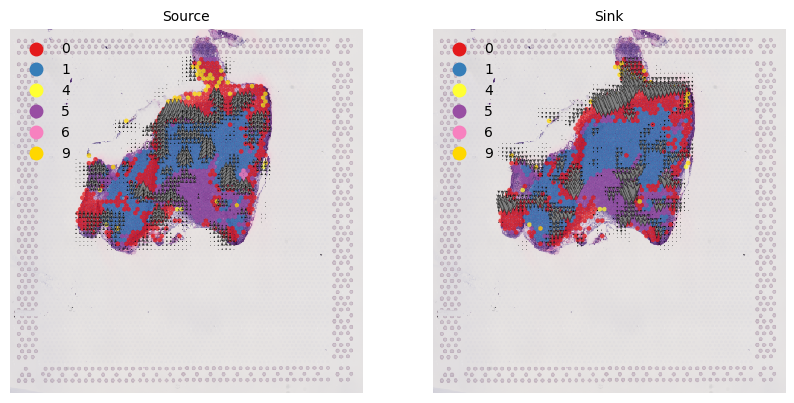

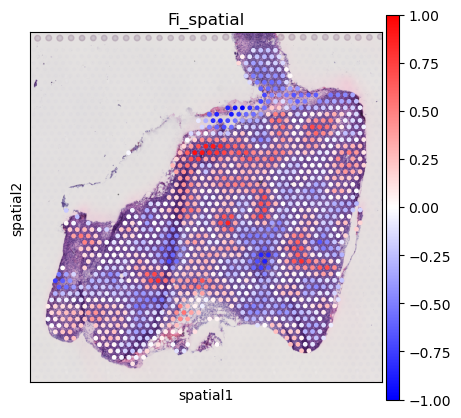

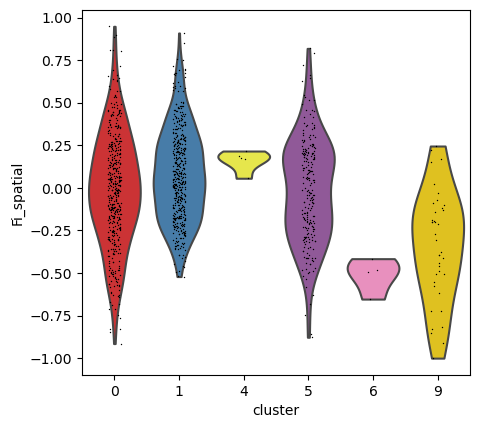

C:\Users\domans\Anaconda3\envs\sc\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:163: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = copy(get_cmap(cmap))


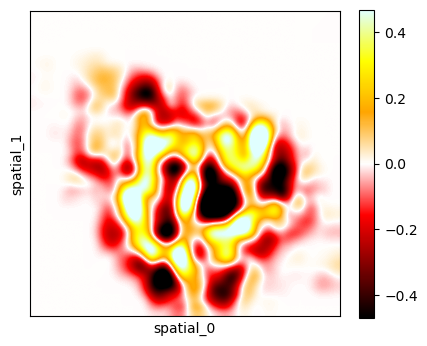

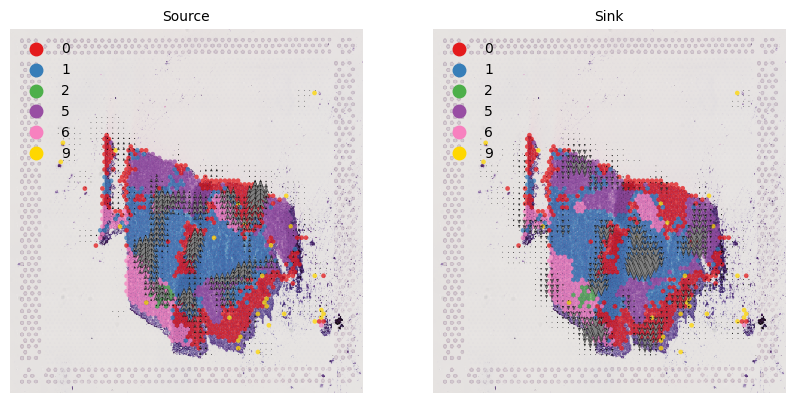

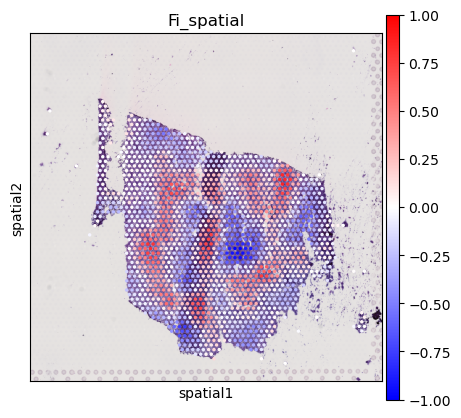

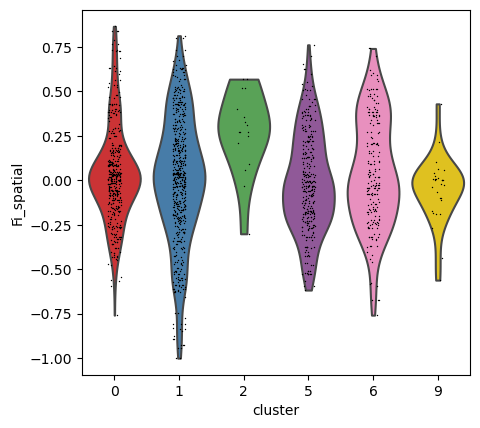

C:\Users\domans\Anaconda3\envs\sc\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:163: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = copy(get_cmap(cmap))


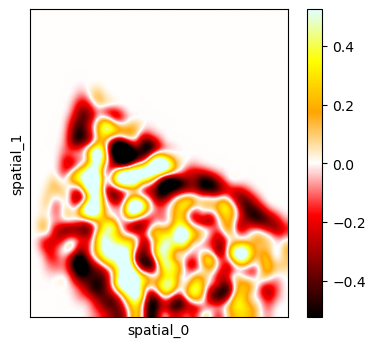

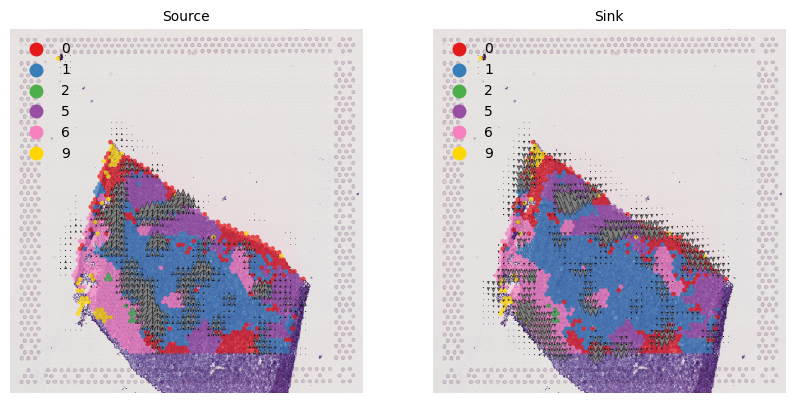

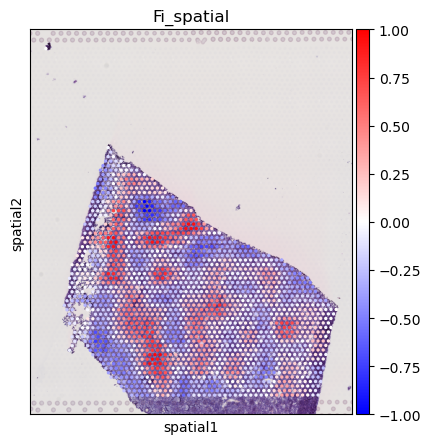

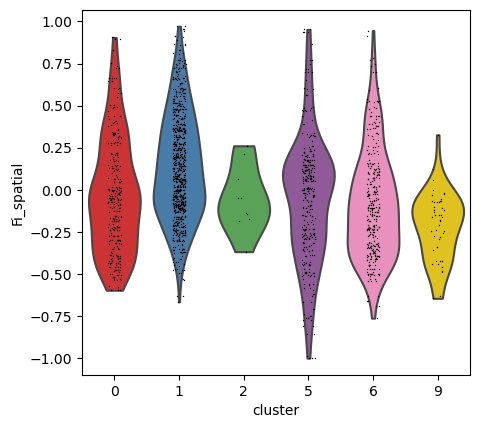

C:\Users\domans\Anaconda3\envs\sc\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:163: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = copy(get_cmap(cmap))


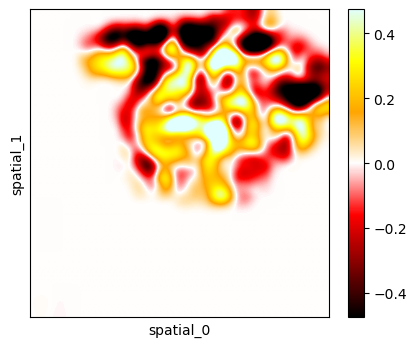

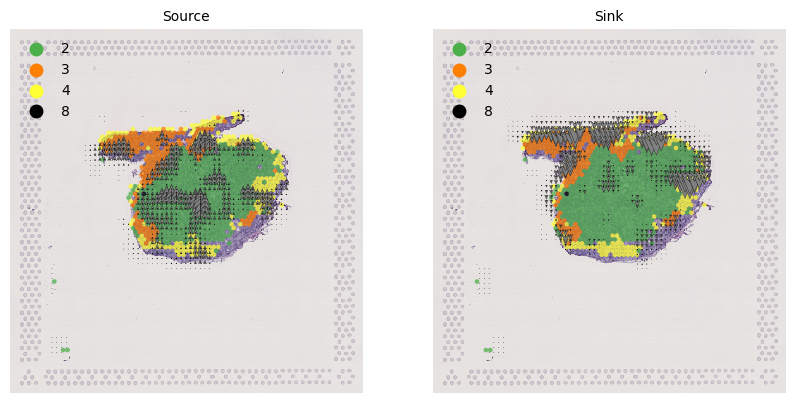

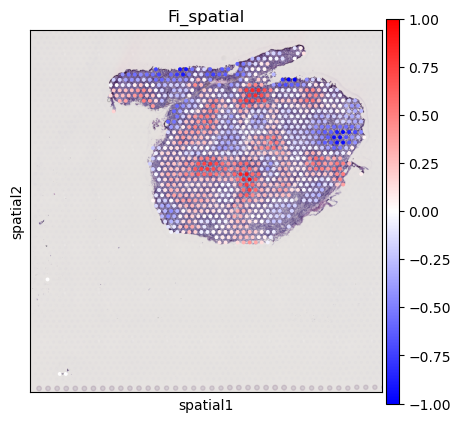

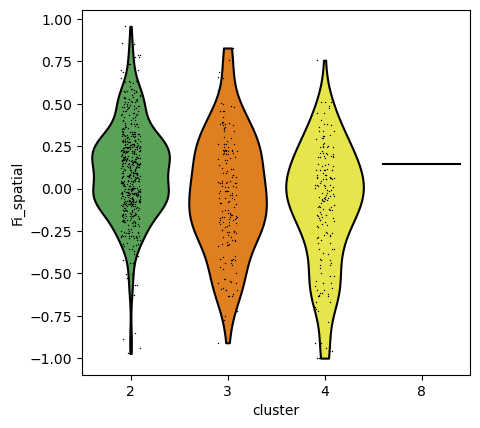

C:\Users\domans\Anaconda3\envs\sc\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:163: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = copy(get_cmap(cmap))


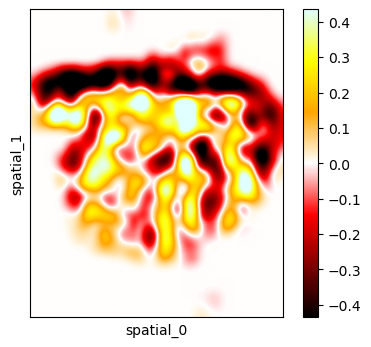

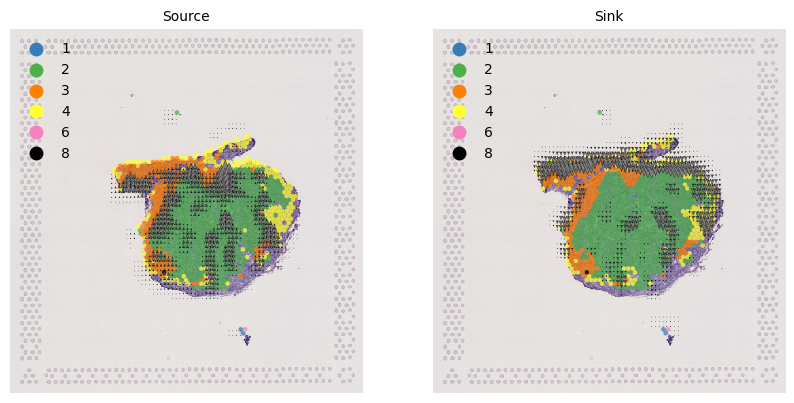

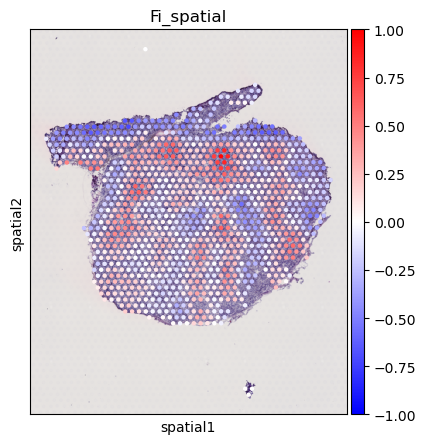

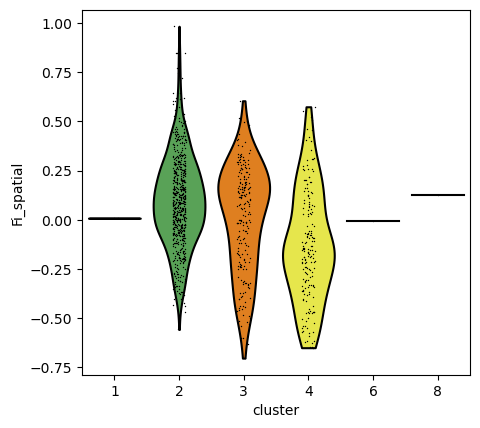

'velocity_spatial'
The 'n_neighbors' parameter of NearestNeighbors must be an int in the range [1, inf) or None. Got 0 instead.


C:\Users\domans\Anaconda3\envs\sc\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:163: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = copy(get_cmap(cmap))


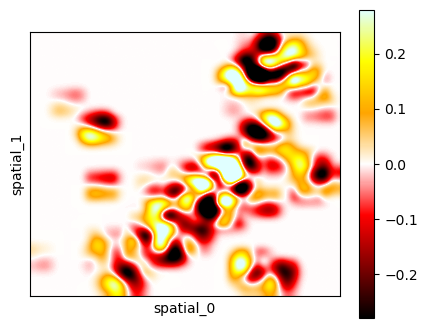

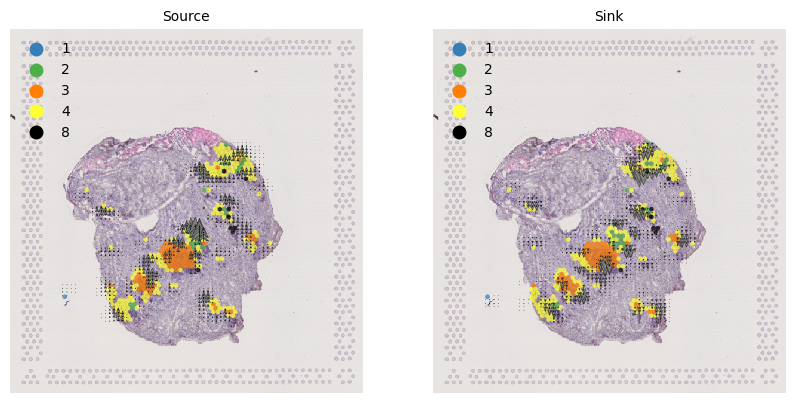

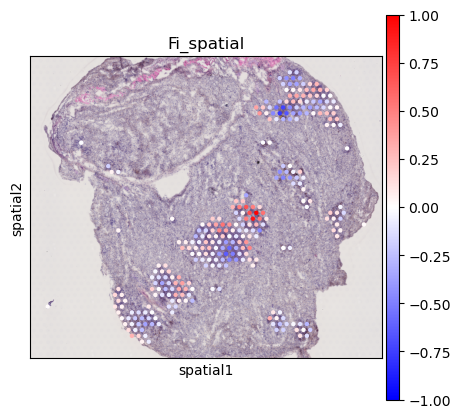

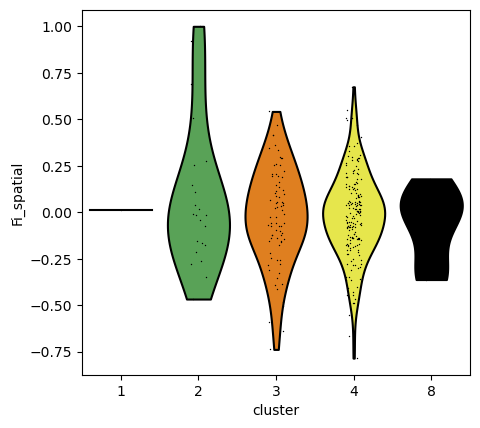

C:\Users\domans\Anaconda3\envs\sc\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:163: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = copy(get_cmap(cmap))


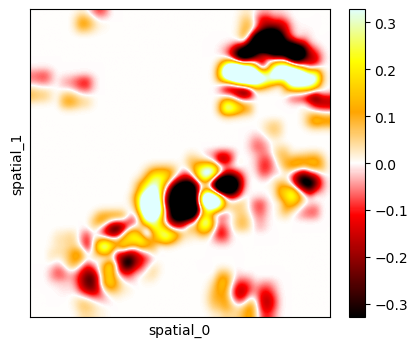

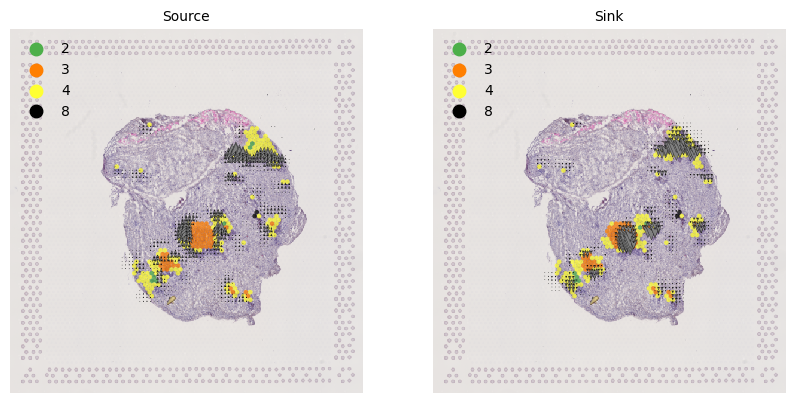

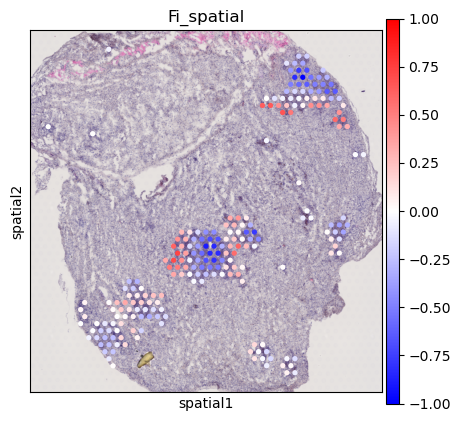

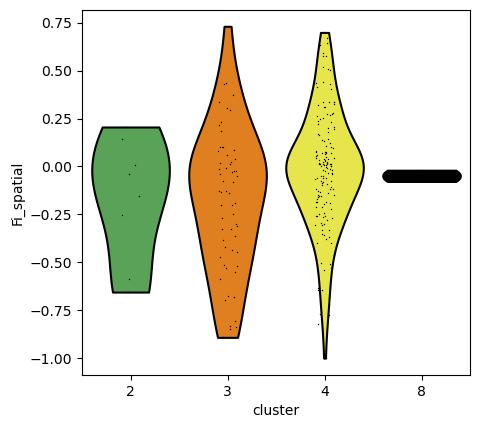

C:\Users\domans\Anaconda3\envs\sc\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:163: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = copy(get_cmap(cmap))


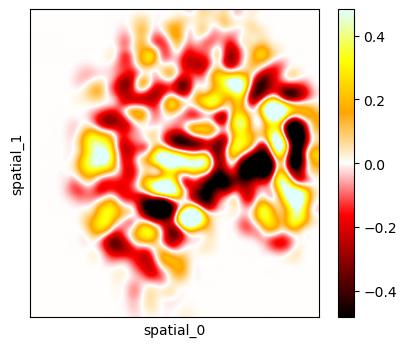

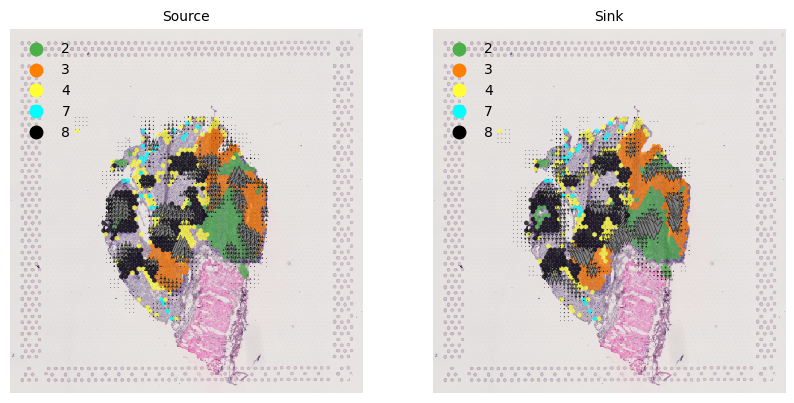

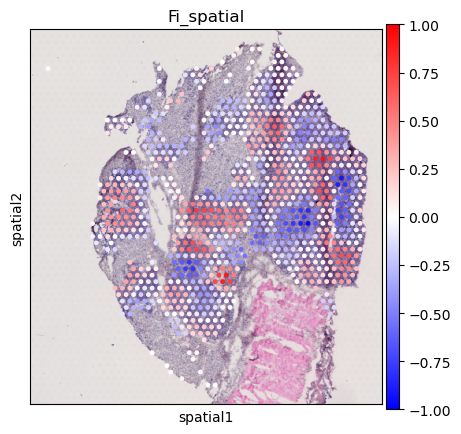

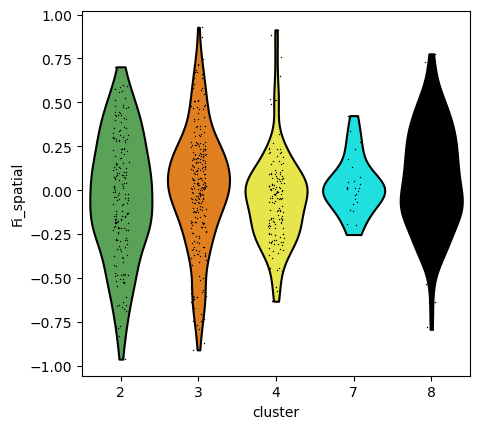

C:\Users\domans\Anaconda3\envs\sc\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:163: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = copy(get_cmap(cmap))


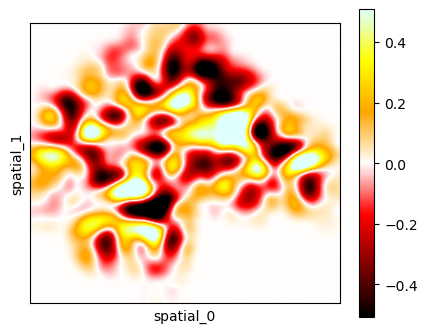

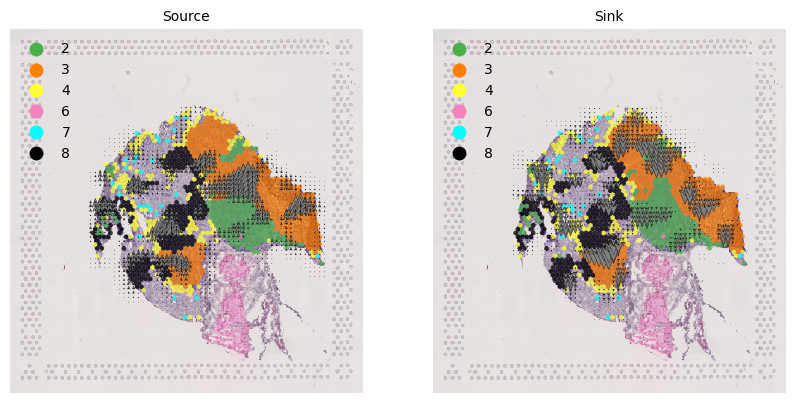

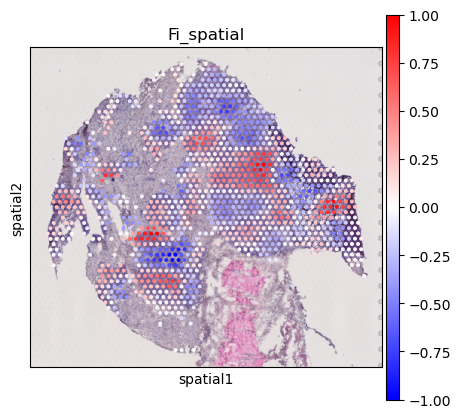

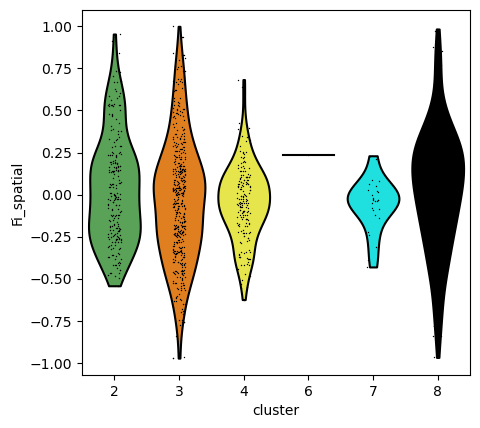

In [41]:
for id in ids:
    ad = ads[id]

    try:
        X_grid_full, V_grid_full, X_emb = computFullGridVelocity(ad, emb='spatial')
        gridPhi = getGridPhi(X_grid_full, V_grid_full, R=2)
        plotPhiHeatmap(gridPhi, X_grid_full, emb='spatial');

        if True:
            fig, axs = plt.subplots(1, 2, figsize=(10, 5))

            params = dict(density=1, arrow_size=100, arrow_length=2000, color=identity, palette=palette_rna, size=45, alpha=0.75) 

            ax = axs[0]
            X_source, V_source = getGridVelocityForSourceSink(X_grid_full, V_grid_full, gridPhi, isSource=True)
            scv.pl.velocity_embedding_grid(ad, basis='X_spatial', X_grid=X_source, V_grid=V_source, legend_loc='none', title='Source', ax=axs[0], show=False, **params)

            (xmin, xmax), (ymin, ymax) = ax.get_xlim(), ax.get_ylim()
            sf = ads[sample].uns['spatial']['library_id']['scalefactors']['tissue_lowres_scalef']
            image = ad.uns['spatial']['library_id']['images']['lowres'].copy()
            ax.imshow(image, interpolation='none', extent=[0, image.shape[1]/sf, -20/sf-image.shape[1]/sf, 0], zorder=-1)
            ax.legend(frameon=False, loc='upper left', fontsize=10, markerscale=1.5)

            ax = axs[1]
            X_sink, V_sink = getGridVelocityForSourceSink(X_grid_full, V_grid_full, gridPhi, isSource=False)
            scv.pl.velocity_embedding_grid(ad, basis='X_spatial', X_grid=X_sink, V_grid=V_sink, legend_loc='none', title='Sink', ax=axs[1], show=False, **params)

            (xmin, xmax), (ymin, ymax) = ax.get_xlim(), ax.get_ylim()
            sf = ads[sample].uns['spatial']['library_id']['scalefactors']['tissue_lowres_scalef']
            image = ad.uns['spatial']['library_id']['images']['lowres'].copy()
            ax.imshow(image, interpolation='none', extent=[0, image.shape[1]/sf, -20/sf-image.shape[1]/sf, 0], zorder=-1)
            ax.legend(frameon=False, loc='upper left', fontsize=10, markerscale=1.5)

        Fi_emb = getFiOfEmb(X_grid_full, gridPhi, X_emb)
        ad.obs['Fi_spatial'] = Fi_emb
        sc.pl.spatial(ad, color='Fi_spatial', cmap='bwr', vmin=-1, vmax=1)
        sc.pl.violin(ad, keys='Fi_spatial', groupby='cluster')
    except Exception as exception:
        print(exception)    

C:\Users\domans\Anaconda3\envs\sc\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:163: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = copy(get_cmap(cmap))
C:\Users\domans\Anaconda3\envs\sc\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:163: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = copy(get_cmap(cmap))
C:\Users\domans\Anaconda3\envs\sc\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:163: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
 

KeyError: 'Could not find key Fi_spatial in .var_names or .obs.columns.'

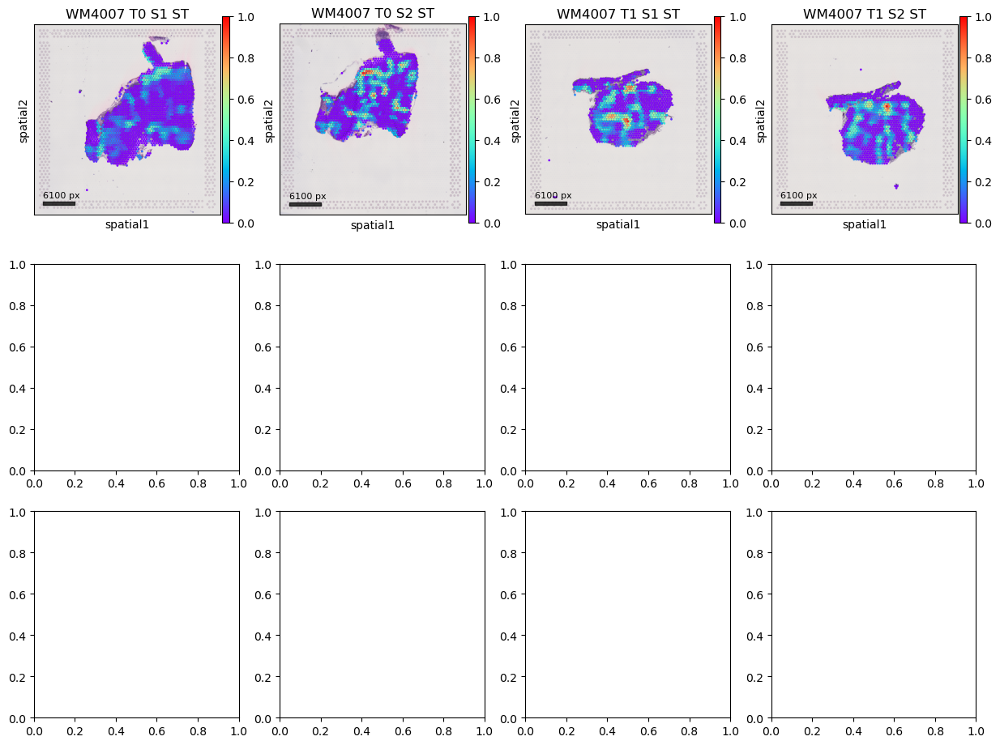

In [37]:
plotSpatialAll(ads, identity='Fi_spatial')

'velocity_spatial'
The 'n_neighbors' parameter of NearestNeighbors must be an int in the range [1, inf) or None. Got 0 instead.


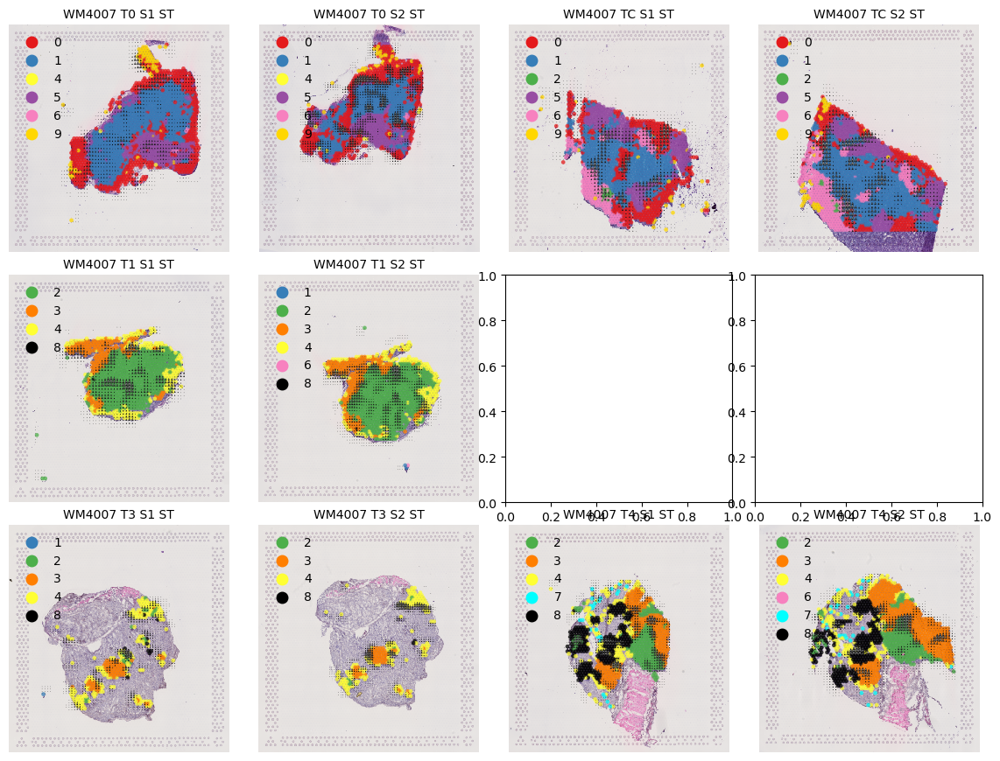

'velocity_spatial'
The 'n_neighbors' parameter of NearestNeighbors must be an int in the range [1, inf) or None. Got 0 instead.


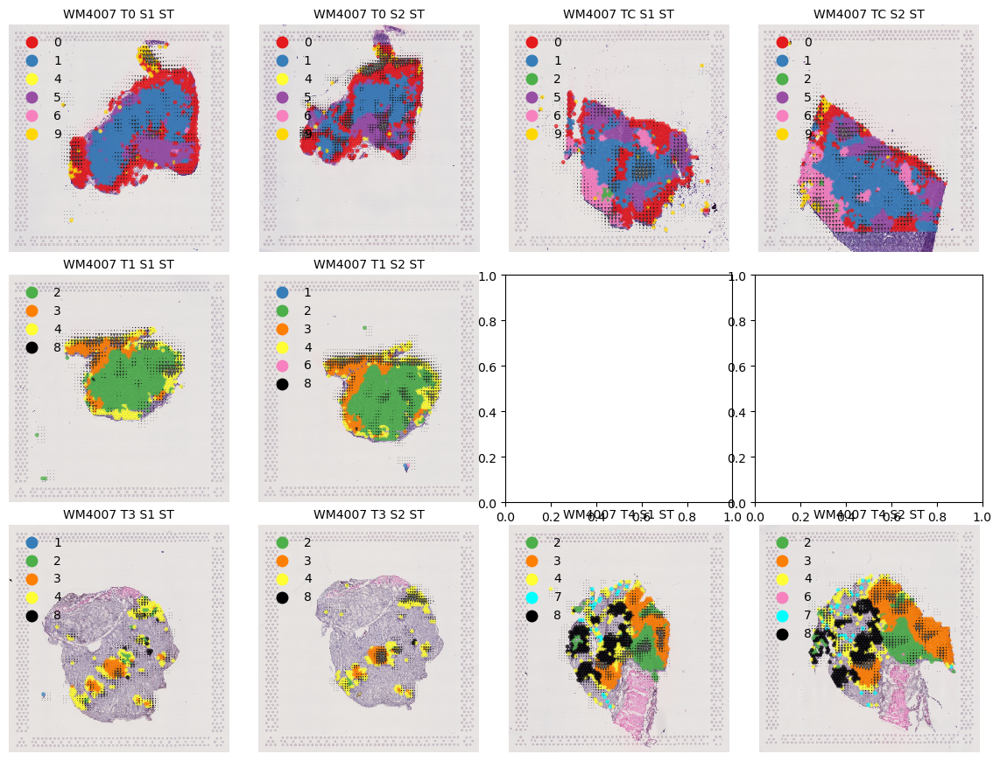

In [40]:
for isSource in [True, False]:
    f = 0.8
    ncols = 4
    nrows = 3
    fig, axs = plt.subplots(nrows, ncols, figsize=(f*4.5*ncols, f*4.5*nrows))
    for isample, sample in enumerate(ids):
        ax = axs[int((isample - isample%ncols)/nrows), isample%ncols]
        identity = 'cluster'
        ad = ads[sample]
        
        try:
            X_grid_full, V_grid_full, X_emb = computFullGridVelocity(ad, emb='spatial')
            gridPhi = getGridPhi(X_grid_full, V_grid_full, R=2)

            params = dict(density=1, arrow_size=100, arrow_length=1000, color=identity, palette=palette_rna, size=45, alpha=0.75) 

            X_source, V_source = getGridVelocityForSourceSink(X_grid_full, V_grid_full, gridPhi, isSource=isSource)
            scv.pl.velocity_embedding_grid(ad, basis='X_spatial', X_grid=X_source, V_grid=V_source, legend_loc='none', title=sample, ax=ax, show=False, **params)

            (xmin, xmax), (ymin, ymax) = ax.get_xlim(), ax.get_ylim()
            sf = ads[sample].uns['spatial']['library_id']['scalefactors']['tissue_lowres_scalef']
            image = ad.uns['spatial']['library_id']['images']['lowres'].copy()
            ax.imshow(image, interpolation='none', extent=[0, image.shape[1]/sf, -20/sf-image.shape[1]/sf, 0], zorder=-1)
            ax.legend(frameon=False, loc='upper left', fontsize=10, markerscale=1.5)
        except Exception as exception:
            print(exception)

    plt.subplots_adjust(wspace=0.1, hspace=0.1)
    suffix = 'source' if isSource else 'sink'
    plt.show()
    fig.savefig(f'{model} spatial rna velocity {suffix}.png', dpi=300)